# **Installing and Importing necessary Libraries**

In [ ]:
!pip install -r Boruta.txt

In [ ]:
# basic imports
import os, random
import pandas as pd
import numpy as np
import datetime
import pandas_ta as ta

# import boruta
from boruta import BorutaPy

# warnings
import warnings
warnings.filterwarnings('ignore')

# plotting & outputs
import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('seaborn')

# stats tools
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

from scipy import stats
from minisom import MiniSom
from collections import defaultdict

# sklearn imports
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# metrics
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from sklearn.metrics import classification_report, ConfusionMatrixDisplay
from sklearn.metrics import roc_auc_score, RocCurveDisplay

# import classifiers
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.base import BaseEstimator, TransformerMixin

# tensorflow
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.metrics import BinaryAccuracy, Accuracy, AUC, Precision, Recall
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from tensorflow.keras.layers import Dropout, Dense, Flatten
from tensorflow.keras.layers import LSTM, BatchNormalization

# kerastuner
import keras_tuner as kt
from kerastuner import HyperParameters
from kerastuner.tuners import RandomSearch, BayesianOptimization, Hyperband

In [ ]:
pd.set_option('display.max_columns', 30)
pd.set_option('display.max_rows', 1000)

Installing Pandas-TA and TALib Properly

In [ ]:
!apt-get install -y build-essential


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
build-essential is already the newest version (12.9ubuntu3).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
!wget http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz
!tar -xzf ta-lib-0.4.0-src.tar.gz
!cd ta-lib/ && ./configure --prefix=/usr && make && make install


--2024-09-30 03:08:27--  http://prdownloads.sourceforge.net/ta-lib/ta-lib-0.4.0-src.tar.gz
Resolving prdownloads.sourceforge.net (prdownloads.sourceforge.net)... 204.68.111.105
Connecting to prdownloads.sourceforge.net (prdownloads.sourceforge.net)|204.68.111.105|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz [following]
--2024-09-30 03:08:27--  http://downloads.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz
Resolving downloads.sourceforge.net (downloads.sourceforge.net)... 204.68.111.105
Reusing existing connection to prdownloads.sourceforge.net:80.
HTTP request sent, awaiting response... 302 Found
Location: http://cytranet-dal.dl.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz?viasf=1 [following]
--2024-09-30 03:08:27--  http://cytranet-dal.dl.sourceforge.net/project/ta-lib/ta-lib/0.4.0/ta-lib-0.4.0-src.tar.gz?viasf=1

In [ ]:
!pip install TA-Lib

In [ ]:
import talib

In [ ]:
!pip install -U git+https://github.com/twopirllc/pandas-ta.git@development

  Cloning https://github.com/twopirllc/pandas-ta.git (to revision development) to /tmp/pip-req-build-g3jjycpy
  Running command git clone --filter=blob:none --quiet https://github.com/twopirllc/pandas-ta.git /tmp/pip-req-build-g3jjycpy
  Running command git checkout -b development --track origin/development
  Switched to a new branch 'development'
  Branch 'development' set up to track remote branch 'development' from 'origin'.
  Resolved https://github.com/twopirllc/pandas-ta.git to commit 438f3a97b71b26bc17efb1a204fb0e0fdc48e0aa
  Preparing metadata (setup.py) ... done


# **Importing Apple Stock Data**

In [ ]:
from twelvedata import TDClient

# Initialize the Twelve Data client with your API key
api_key = '1759522c57b545099b9d46d37581229b'
td = TDClient(apikey=api_key)

# Get historical stock data for a specific symbol
apple = td.time_series(symbol="AAPL", interval="1day", outputsize=5000 ).as_pandas()

In [ ]:
apple.index = pd.to_datetime(apple.index)
apple.sort_index(inplace=True)

In [ ]:
# Display the fetched data
apple.head()

,open,high,low,close,volume
datetime,,,,,
2004-11-16,0.98500,0.98571,0.97286,0.98107,295103200
2004-11-17,0.98554,0.99018,0.96821,0.98036,397751200
2004-11-18,0.96964,0.99018,0.96946,0.98911,459149600
2004-11-19,0.99089,1.01625,0.97321,0.98518,765279200
2004-11-22,1.10357,1.14286,1.03393,1.09554,2568210400


In [ ]:
apple.tail()

,open,high,low,close,volume
datetime,,,,,
2024-09-23,227.34000,229.45000,225.81,226.47000,54146000
2024-09-24,228.64999,229.35001,225.73,227.37000,43556100
2024-09-25,224.92999,227.28999,224.02,226.37000,42308700
2024-09-26,227.30000,228.50000,225.41,227.52000,36636700
2024-09-27,228.46001,229.52000,227.30,227.78999,33993600


Calculate daily returns using Close Price

In [ ]:
apple['daily_returns'] = apple['close'].pct_change()
apple.dropna(inplace=True)

In [ ]:
apple.head()

,open,high,low,close,volume,daily_returns
datetime,,,,,,
2004-11-17,0.98554,0.99018,0.96821,0.98036,397751200,-0.000724
2004-11-18,0.96964,0.99018,0.96946,0.98911,459149600,0.008925
2004-11-19,0.99089,1.01625,0.97321,0.98518,765279200,-0.003973
2004-11-22,1.10357,1.14286,1.03393,1.09554,2568210400,0.112020
2004-11-23,1.11250,1.11518,1.09018,1.09411,911450400,-0.001305


# **Exploratory Data Analysis**

In [ ]:
apple.describe()

,open,high,low,close,volume,daily_returns
count,4999.000000,4999.000000,4999.000000,4999.000000,4.999000e+03,4999.000000
mean,50.537535,51.077815,50.019441,50.570899,3.930640e+08,0.001299
std,60.086854,60.731639,59.488186,60.139028,3.985852e+08,0.020424
min,0.969640,0.990180,0.968210,0.980360,2.404830e+07,-0.179194
25%,6.978215,7.052320,6.877855,6.960180,1.031926e+08,-0.008378
50%,24.285360,24.470000,24.035710,24.285000,2.402268e+08,0.001008
75%,57.380000,57.848750,56.753750,57.315000,5.658464e+08,0.011741
max,236.480000,237.230000,233.090000,234.820010,3.372970e+09,0.139051


**Visulaizing close price and volume data**

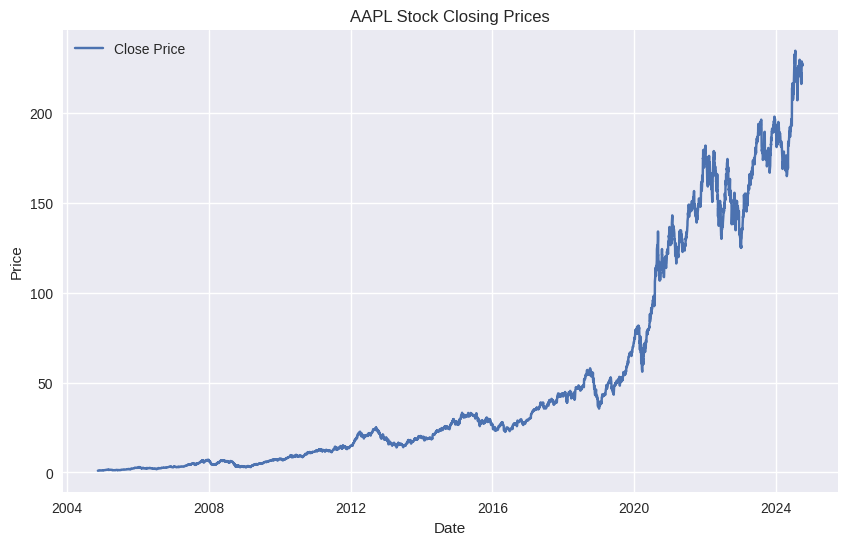

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=apple['close'], label='Close Price')
plt.title('AAPL Stock Closing Prices')
plt.xlabel('Date')
plt.ylabel('Price')
plt.grid(True)
plt.show()

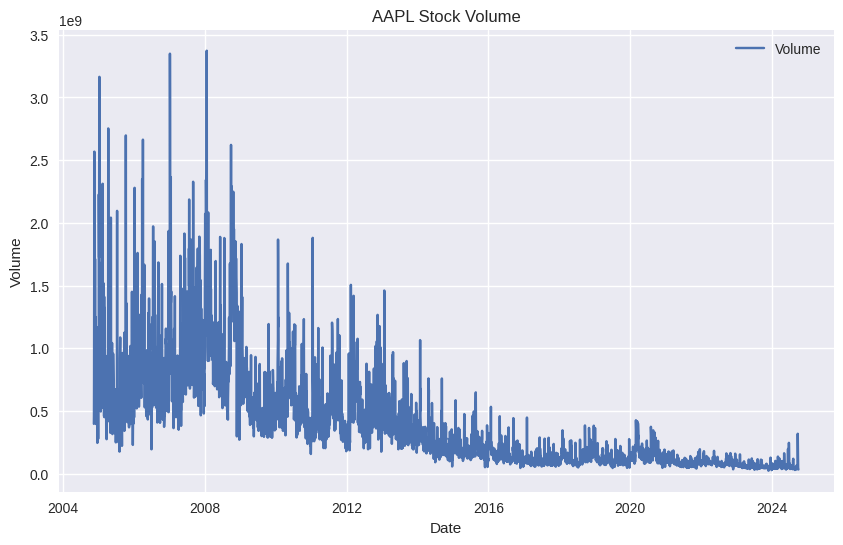

In [ ]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=apple['volume'], label='Volume')
plt.title('AAPL Stock Volume')
plt.xlabel('Date')
plt.ylabel('Volume')
plt.grid(True)
plt.show()

**Visualize daily returns distribution**

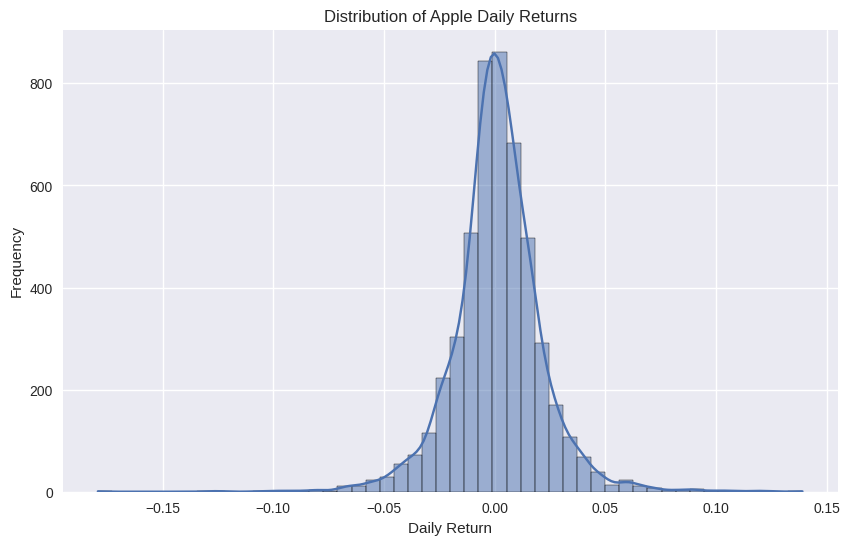

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(apple['daily_returns'], bins=50, kde=True)
plt.title('Distribution of Apple Daily Returns')
plt.xlabel('Daily Return')
plt.ylabel('Frequency')
plt.show()

It shows that the returns are most daily returns are around zero witha few larger positive and negative returns at the tails of the distribution

# **Feature Extraction - Technical Indicators**

In [ ]:
apple_ohlcv = apple[['open', 'high', 'low', 'close', 'volume']]

apple_ohlcv.ta.study('All')

In [ ]:
apple_ohlcv.columns.to_list()

['open',
 'high',
 'low',
 'close',
 'volume',
 'ABER_ZG_5_15',
 'ABER_SG_5_15',
 'ABER_XG_5_15',
 'ABER_ATR_5_15',
 'ACCBL_20',
 'ACCBM_20',
 'ACCBU_20',
 'AD',
 'ADOSC_3_10',
 'ADX_14',
 'ADXR_14_2',
 'DMP_14',
 'DMN_14',
 'AGj_13_8_5',
 'AGt_13_8_5',
 'AGl_13_8_5',
 'ALMA_9_6.0_0.85',
 'ALPHAT_14_1_50',
 'ALPHATl_14_1_50_2',
 'AMATe_LR_8_21_2',
 'AMATe_SR_8_21_2',
 'AO_5_34',
 'OBV',
 'OBV_min_2',
 'OBV_max_2',
 'OBVe_4',
 'OBVe_12',
 'AOBV_LR_2',
 'AOBV_SR_2',
 'APO_12_26',
 'AROOND_14',
 'AROONU_14',
 'AROONOSC_14',
 'ATRr_14',
 'ATRTSe_14_20_3.0',
 'BBL_5_2.0',
 'BBM_5_2.0',
 'BBU_5_2.0',
 'BBB_5_2.0',
 'BBP_5_2.0',
 'BIAS_SMA_26',
 'BOP',
 'AR_26',
 'BR_26',
 'CCI_14_0.015',
 'CDL_2CROWS',
 'CDL_3BLACKCROWS',
 'CDL_3INSIDE',
 'CDL_3LINESTRIKE',
 'CDL_3OUTSIDE',
 'CDL_3STARSINSOUTH',
 'CDL_3WHITESOLDIERS',
 'CDL_ABANDONEDBABY',
 'CDL_ADVANCEBLOCK',
 'CDL_BELTHOLD',
 'CDL_BREAKAWAY',
 'CDL_CLOSINGMARUBOZU',
 'CDL_CONCEALBABYSWALL',
 'CDL_COUNTERATTACK',
 'CDL_DARKCLOUDCOVER',
 'CD

In [ ]:
# Merge the new features to the original dataset
apple = apple.join(apple_ohlcv, how='outer', rsuffix='_tech')

In [ ]:
apple

,open,high,low,close,volume,daily_returns,open_tech,high_tech,low_tech,close_tech,volume_tech,ABER_ZG_5_15,ABER_SG_5_15,ABER_XG_5_15,ABER_ATR_5_15,...,VTXP_14,VTXM_14,VWAP_D,VWMA_10,TSV_18_10,TSVs_18_10,TSVr_18_10,WCP,WILLR_14,WMA_10,ZIGZAGs_5.0%_10,ZIGZAGv_5.0%_10,ZIGZAGd_5.0%_10,ZL_EMA_10,ZS_30
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.98554,0.99018,0.96821,0.98036,397751200,-0.000724,0.98554,0.99018,0.96821,0.98036,397751200,NaN,NaN,NaN,NaN,...,NaN,NaN,0.979583,NaN,NaN,NaN,NaN,0.979777,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-18,0.96964,0.99018,0.96946,0.98911,459149600,0.008925,0.96964,0.99018,0.96946,0.98911,459149600,NaN,NaN,NaN,NaN,...,NaN,NaN,0.982917,NaN,NaN,NaN,NaN,0.984465,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-19,0.99089,1.01625,0.97321,0.98518,765279200,-0.003973,0.99089,1.01625,0.97321,0.98518,765279200,NaN,NaN,NaN,NaN,...,NaN,NaN,0.991547,NaN,NaN,NaN,NaN,0.989955,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-22,1.10357,1.14286,1.03393,1.09554,2568210400,0.112020,1.10357,1.14286,1.03393,1.09554,2568210400,NaN,NaN,NaN,NaN,...,NaN,NaN,1.090777,NaN,NaN,NaN,NaN,1.091967,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-11-23,1.11250,1.11518,1.09018,1.09411,911450400,-0.001305,1.11250,1.11518,1.09018,1.09411,911450400,1.028929,NaN,NaN,NaN,...,NaN,NaN,1.099823,NaN,NaN,NaN,NaN,1.098395,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23,227.34000,229.45000,225.81000,226.47000,54146000,-0.007581,227.34000,229.45000,225.81000,226.47000,54146000,224.205999,229.279035,219.132964,5.073035,...,1.033710,0.901833,227.243333,224.585169,-1.456445e+08,-2.075561e+08,0.701712,227.050000,-34.533125,223.643091,NaN,NaN,NaN,227.018945,0.724011
2024-09-24,228.64999,229.35001,225.73000,227.37000,43556100,0.003974,228.64999,229.35001,225.73000,227.37000,43556100,226.490001,231.466168,221.513834,4.976167,...,1.100968,0.810920,227.483337,225.044456,-4.784404e+07,-1.997876e+08,0.239475,227.455003,-29.838289,224.521636,NaN,NaN,NaN,228.297319,0.917095
2024-09-25,224.92999,227.28999,224.02000,226.37000,42308700,-0.004398,224.92999,227.28999,224.02000,226.37000,42308700,227.606001,232.473756,222.738245,4.867756,...,1.026931,0.900809,225.893330,225.256877,-2.614425e+08,-2.108245e+08,1.240096,226.012497,-35.054773,225.086363,NaN,NaN,NaN,227.492352,0.585979


# **Choosing the Threshold**

In [ ]:
print("Summary Statistics :")
apple['daily_returns'].describe()

Summary Statistics :


,daily_returns
count,4999.000000
mean,0.001299
std,0.020424
min,-0.179194
25%,-0.008378
50%,0.001008
75%,0.011741
max,0.139051


In [ ]:
# Calculate percentiles to determine the threshold
percentiles = np.percentile(apple['daily_returns'], [1, 5, 50, 75, 95, 99])
print("\n1st, 5th, 50th, 75th,95th, 99th Percentiles of Daily Returns:")
print(percentiles)


1st, 5th, 50th, 75th,95th, 99th Percentiles of Daily Returns:
[-0.05463511 -0.03004142  0.00100812  0.01174109  0.03287189  0.0598144 ]


In [ ]:
# Calculating Volatility (Standard Deviation)
volatility = apple['daily_returns'].std()
print("\nVolatility (Standard Deviation):")
print(volatility)


Volatility (Standard Deviation):
0.020424436545503195


In [ ]:
# we take the threshold as a multiple of the standard deviation
threshold = 0.003
print("\nChosen Threshold:")
print(threshold)


Chosen Threshold:
0.003


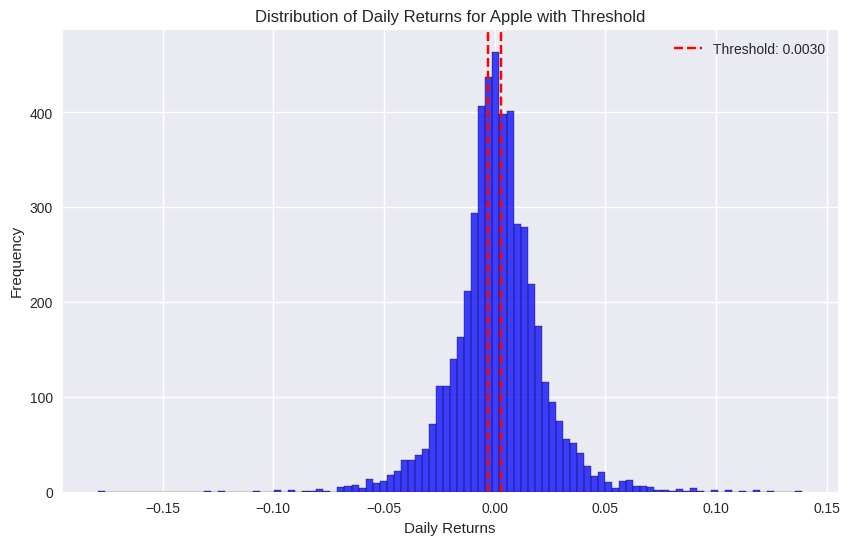

In [ ]:
# Visualize the threshold on the histogram
plt.figure(figsize=(10, 6))
plt.hist(apple['daily_returns'], bins=100, alpha=0.75, color='blue', edgecolor='black')
plt.axvline(x=threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.4f}')
plt.axvline(x=-threshold, color='red', linestyle='--')
plt.title('Distribution of Daily Returns for Apple with Threshold')
plt.xlabel('Daily Returns')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

# **Handling Inf and NaN values**

In [ ]:
inf_values = np.isinf(apple)
print(inf_values)

             open   high    low  close  volume  daily_returns  open_tech  \
datetime                                                                   
2004-11-17  False  False  False  False   False          False      False   
2004-11-18  False  False  False  False   False          False      False   
2004-11-19  False  False  False  False   False          False      False   
2004-11-22  False  False  False  False   False          False      False   
2004-11-23  False  False  False  False   False          False      False   
...           ...    ...    ...    ...     ...            ...        ...   
2024-09-23  False  False  False  False   False          False      False   
2024-09-24  False  False  False  False   False          False      False   
2024-09-25  False  False  False  False   False          False      False   
2024-09-26  False  False  False  False   False          False      False   
2024-09-27  False  False  False  False   False          False      False   

           

In [ ]:
rows_with_inf = apple[inf_values.any(axis=1)]
print(rows_with_inf)

                 open       high       low      close     volume  \
datetime                                                           
2014-06-12   23.51000   23.53000   22.9750   23.07250  218996000   
2014-06-13   23.05000   23.11000   22.7200   22.82000  218100000   
2014-06-16   22.87750   23.18750   22.8625   23.05000  142244000   
2014-06-17   23.07750   23.17500   22.9500   23.02000  118904000   
2014-06-18   23.06750   23.07250   22.8375   23.04500  134056000   
...               ...        ...       ...        ...        ...   
2024-09-23  227.34000  229.45000  225.8100  226.47000   54146000   
2024-09-24  228.64999  229.35001  225.7300  227.37000   43556100   
2024-09-25  224.92999  227.28999  224.0200  226.37000   42308700   
2024-09-26  227.30000  228.50000  225.4100  227.52000   36636700   
2024-09-27  228.46001  229.52000  227.3000  227.78999   33993600   

            daily_returns  open_tech  high_tech  low_tech  close_tech  \
datetime                                  

In [ ]:
apple.drop(columns=['ZIGZAGs_5.0%_10', 'ZIGZAGv_5.0%_10', 'ZIGZAGd_5.0%_10'], inplace=True)

In [ ]:
apple.replace([np.inf, -np.inf], np.nan, inplace=True)

# **Defining Target Variable**

In [ ]:
apple['target'] = np.where(apple['daily_returns'] > threshold, 1, 0)

# 2. Backfill missing values to address missing data
apple = apple.bfill(axis=1)

# 3. Remove any remaining rows with NaN values (if needed)
apple.dropna(inplace=True)

# 4. Check for missing values to ensure they're handled
print(apple.isna().sum())

open                            0
high                            0
low                             0
close                           0
volume                          0
daily_returns                   0
open_tech                       0
high_tech                       0
low_tech                        0
close_tech                      0
volume_tech                     0
ABER_ZG_5_15                    0
ABER_SG_5_15                    0
ABER_XG_5_15                    0
ABER_ATR_5_15                   0
ACCBL_20                        0
ACCBM_20                        0
ACCBU_20                        0
AD                              0
ADOSC_3_10                      0
ADX_14                          0
ADXR_14_2                       0
DMP_14                          0
DMN_14                          0
AGj_13_8_5                      0
AGt_13_8_5                      0
AGl_13_8_5                      0
ALMA_9_6.0_0.85                 0
ALPHAT_14_1_50                  0
ALPHATl_14_1_5

In [ ]:
apple.head()

,open,high,low,close,volume,daily_returns,open_tech,high_tech,low_tech,close_tech,volume_tech,ABER_ZG_5_15,ABER_SG_5_15,ABER_XG_5_15,ABER_ATR_5_15,...,VHM_610,VIDYA_14,VTXP_14,VTXM_14,VWAP_D,VWMA_10,TSV_18_10,TSVs_18_10,TSVr_18_10,WCP,WILLR_14,WMA_10,ZL_EMA_10,ZS_30,target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.98554,0.99018,0.96821,0.98036,3.977512e+08,-0.000724,0.98554,0.99018,0.96821,0.98036,3.977512e+08,4.218299e+07,4.218299e+07,4.218299e+07,4.218299e+07,...,0.979583,0.979583,0.979583,0.979583,0.979583,0.979777,0.979777,0.979777,0.979777,0.979777,0.0,0.0,0.0,0.0,0.0
2004-11-18,0.96964,0.99018,0.96946,0.98911,4.591496e+08,0.008925,0.96964,0.99018,0.96946,0.98911,4.591496e+08,4.539108e+08,4.539108e+08,4.539108e+08,4.539108e+08,...,0.982917,0.982917,0.982917,0.982917,0.982917,0.984465,0.984465,0.984465,0.984465,0.984465,1.0,1.0,1.0,1.0,1.0
2004-11-19,0.99089,1.01625,0.97321,0.98518,7.652792e+08,-0.003973,0.99089,1.01625,0.97321,0.98518,7.652792e+08,1.143003e+08,1.143003e+08,1.143003e+08,1.143003e+08,...,0.991547,0.991547,0.991547,0.991547,0.991547,0.989955,0.989955,0.989955,0.989955,0.989955,0.0,0.0,0.0,0.0,0.0
2004-11-22,1.10357,1.14286,1.03393,1.09554,2.568210e+09,0.112020,1.10357,1.14286,1.03393,1.09554,2.568210e+09,4.512114e+08,4.512114e+08,4.512114e+08,4.512114e+08,...,1.090777,1.090777,1.090777,1.090777,1.090777,1.091967,1.091967,1.091967,1.091967,1.091967,1.0,1.0,1.0,1.0,1.0
2004-11-23,1.11250,1.11518,1.09018,1.09411,9.114504e+08,-0.001305,1.11250,1.11518,1.09018,1.09411,9.114504e+08,1.028929e+00,-1.736789e+08,-1.736789e+08,-1.736789e+08,...,1.099823,1.099823,1.099823,1.099823,1.099823,1.098395,1.098395,1.098395,1.098395,1.098395,0.0,0.0,0.0,0.0,0.0


In [ ]:
apple.tail()

,open,high,low,close,volume,daily_returns,open_tech,high_tech,low_tech,close_tech,volume_tech,ABER_ZG_5_15,ABER_SG_5_15,ABER_XG_5_15,ABER_ATR_5_15,...,VHM_610,VIDYA_14,VTXP_14,VTXM_14,VWAP_D,VWMA_10,TSV_18_10,TSVs_18_10,TSVr_18_10,WCP,WILLR_14,WMA_10,ZL_EMA_10,ZS_30,target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2024-09-23,227.34000,229.45000,225.81,226.47000,54146000.0,-0.007581,227.34000,229.45000,225.81,226.47000,54146000.0,224.205999,229.279035,219.132964,5.073035,...,-0.024608,1.033710,1.033710,0.901833,227.243333,224.585169,-1.456445e+08,-2.075561e+08,0.701712,227.050000,-34.533125,223.643091,227.018945,0.724011,0.0
2024-09-24,228.64999,229.35001,225.73,227.37000,43556100.0,0.003974,228.64999,229.35001,225.73,227.37000,43556100.0,226.490001,231.466168,221.513834,4.976167,...,-0.043455,1.100968,1.100968,0.810920,227.483337,225.044456,-4.784404e+07,-1.997876e+08,0.239475,227.455003,-29.838289,224.521636,228.297319,0.917095,1.0
2024-09-25,224.92999,227.28999,224.02,226.37000,42308700.0,-0.004398,224.92999,227.28999,224.02,226.37000,42308700.0,227.606001,232.473756,222.738245,4.867756,...,-0.045552,1.026931,1.026931,0.900809,225.893330,225.256877,-2.614425e+08,-2.108245e+08,1.240096,226.012497,-35.054773,225.086363,227.492352,0.585979,0.0
2024-09-26,227.30000,228.50000,225.41,227.52000,36636700.0,0.005080,227.30000,228.50000,225.41,227.52000,36636700.0,227.480000,232.229239,222.730761,4.749239,...,-0.055544,1.075797,1.075797,0.875095,227.143333,225.487569,-1.774481e+08,-2.079771e+08,0.853210,227.237500,-29.055816,225.792727,227.373742,0.858620,1.0
2024-09-27,228.46001,229.52000,227.30,227.78999,33993600.0,0.001187,228.46001,229.52000,227.30,227.78999,33993600.0,227.193333,231.773955,222.612710,4.580623,...,-0.060084,1.156887,1.156887,0.791554,228.203330,225.734798,1.444173e+08,-1.726016e+08,-0.836709,228.099995,-27.647418,226.461816,227.689422,0.894172,0.0


# **Class Imbalance**

In [ ]:
c = apple['target'].value_counts()
c

,count
target,
0.0,2773
1.0,2226


In [ ]:
# Class Imbalance Handling
def cwts(dfs):
    c0, c1 = np.bincount(dfs['target'])
    w0 = (1/c0) * (len(dfs)) / 2
    w1 = (1/c1) * (len(dfs)) / 2
    return {0: w0, 1: w1}

class_weight = cwts(apple)
print(f"Class Weights: {class_weight}")

Class Weights: {0: 0.9013703570140642, 1: 1.1228661275831089}


In [ ]:
class_weight[0] * c[0], class_weight[1] * c[1]

(2499.5, 2499.5000000000005)

# **Feature Selection and Transformation**

#### **Dealing with Multicollinearity**

In [ ]:
X_vif = apple.drop(columns=['target'])

X_vif = sm.add_constant(X_vif)

# Function to calculate VIF and drop columns with inf or NaN VIF values
def calculate_vif_and_clean(X):
    vif_data = pd.DataFrame()
    vif_data["Feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    # Identify and drop features with inf or NaN VIF values
    features_to_drop = vif_data[vif_data["VIF"].isin([float('inf'), float('nan')])]["Feature"]
    X_cleaned = X.drop(columns=features_to_drop)

    return X_cleaned, vif_data.sort_values(by="VIF", ascending=False)

In [ ]:
# Iteratively drop features with inf or NaN VIF values
while True:
    X_vif, vif_data_cleaned = calculate_vif_and_clean(X_vif)

    # Break the loop if no more inf or NaN VIF values are present
    if not vif_data_cleaned["VIF"].isin([float('inf'), float('nan')]).any():
        break

X_vif = X_vif.drop(columns=['const'], errors='ignore')

In [ ]:
apple_after_vif = apple[X_vif.columns].copy()
apple_after_vif['target'] = apple['target']

vif_data_cleaned

,Feature,VIF
320,VHM_610,1.066987
115,CFO_9,1.002242
218,PPOh_12_26_9,1.001686
90,CDL_MARUBOZU,1.001245
284,STOCHh_14_3_3,1.000634
185,KVO_34_55_13,1.000572
241,REMAP_0.0_100.0_-1.0_1.0,1.000272
81,CDL_HIKKAKE,1.000232
250,RWIl_14,1.000230
240,REFLEX_20_20_0.04,1.000167


In [ ]:
apple_after_vif

,open,high,low,close,volume,daily_returns,open_tech,high_tech,low_tech,close_tech,volume_tech,ABER_ZG_5_15,ABER_SG_5_15,ABER_XG_5_15,ABER_ATR_5_15,...,VHF_28,VHM_610,VTXP_14,VTXM_14,VWAP_D,VWMA_10,TSV_18_10,TSVs_18_10,TSVr_18_10,WCP,WILLR_14,WMA_10,ZL_EMA_10,ZS_30,target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.98554,0.99018,0.96821,0.98036,3.977512e+08,-0.000724,0.98554,0.99018,0.96821,0.98036,3.977512e+08,4.218299e+07,4.218299e+07,4.218299e+07,4.218299e+07,...,0.979583,0.979583,0.979583,0.979583,0.979583,0.979777,9.797775e-01,9.797775e-01,0.979777,0.979777,0.000000,0.000000,0.000000,0.000000,0.0
2004-11-18,0.96964,0.99018,0.96946,0.98911,4.591496e+08,0.008925,0.96964,0.99018,0.96946,0.98911,4.591496e+08,4.539108e+08,4.539108e+08,4.539108e+08,4.539108e+08,...,0.982917,0.982917,0.982917,0.982917,0.982917,0.984465,9.844650e-01,9.844650e-01,0.984465,0.984465,1.000000,1.000000,1.000000,1.000000,1.0
2004-11-19,0.99089,1.01625,0.97321,0.98518,7.652792e+08,-0.003973,0.99089,1.01625,0.97321,0.98518,7.652792e+08,1.143003e+08,1.143003e+08,1.143003e+08,1.143003e+08,...,0.991547,0.991547,0.991547,0.991547,0.991547,0.989955,9.899550e-01,9.899550e-01,0.989955,0.989955,0.000000,0.000000,0.000000,0.000000,0.0
2004-11-22,1.10357,1.14286,1.03393,1.09554,2.568210e+09,0.112020,1.10357,1.14286,1.03393,1.09554,2.568210e+09,4.512114e+08,4.512114e+08,4.512114e+08,4.512114e+08,...,1.090777,1.090777,1.090777,1.090777,1.090777,1.091967,1.091967e+00,1.091967e+00,1.091967,1.091967,1.000000,1.000000,1.000000,1.000000,1.0
2004-11-23,1.11250,1.11518,1.09018,1.09411,9.114504e+08,-0.001305,1.11250,1.11518,1.09018,1.09411,9.114504e+08,1.028929e+00,-1.736789e+08,-1.736789e+08,-1.736789e+08,...,1.099823,1.099823,1.099823,1.099823,1.099823,1.098395,1.098395e+00,1.098395e+00,1.098395,1.098395,0.000000,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23,227.34000,229.45000,225.81000,226.47000,5.414600e+07,-0.007581,227.34000,229.45000,225.81000,226.47000,5.414600e+07,2.242060e+02,2.292790e+02,2.191330e+02,5.073035e+00,...,0.254824,-0.024608,1.033710,0.901833,227.243333,224.585169,-1.456445e+08,-2.075561e+08,0.701712,227.050000,-34.533125,223.643091,227.018945,0.724011,0.0
2024-09-24,228.64999,229.35001,225.73000,227.37000,4.355610e+07,0.003974,228.64999,229.35001,225.73000,227.37000,4.355610e+07,2.264900e+02,2.314662e+02,2.215138e+02,4.976167e+00,...,0.252673,-0.043455,1.100968,0.810920,227.483337,225.044456,-4.784404e+07,-1.997876e+08,0.239475,227.455003,-29.838289,224.521636,228.297319,0.917095,1.0
2024-09-25,224.92999,227.28999,224.02000,226.37000,4.230870e+07,-0.004398,224.92999,227.28999,224.02000,226.37000,4.230870e+07,2.276060e+02,2.324738e+02,2.227382e+02,4.867756e+00,...,0.262522,-0.045552,1.026931,0.900809,225.893330,225.256877,-2.614425e+08,-2.108245e+08,1.240096,226.012497,-35.054773,225.086363,227.492352,0.585979,0.0


# **Feature selection using RFE (Recursive Feature Elimination)**

In [ ]:
apple_new = apple_after_vif.copy()

X = apple_new.drop(columns=['target'])
y = apple_new['target']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

#### **Apply MinMax Scaler for Feature Scaling**

In [ ]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

#### **Using SVC as the base model for RFE**

In [ ]:
# Define a range of C values to explore
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000]}

In [ ]:
# Initialize the SVM with a linear kernel
svc = SVC(kernel="linear", random_state=42, class_weight=class_weight)

In [ ]:
# Perform Grid Search with Cross-Validation
grid_search = GridSearchCV(svc, param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train_scaled, y_train)

# Get the best model and parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

print(f"Best Parameters: {best_params}")
print(f"Best Cross-Validation Accuracy: {grid_search.best_score_}")

Best Parameters: {'C': 1000}
Best Cross-Validation Accuracy: 0.9622334167709639


####**Perform RFE to select top 50 Features**

In [ ]:
# Perform RFE to select top features
rfe = RFE(estimator=best_model, n_features_to_select=50, step=10)
rfe.fit(X_train_scaled, y_train)

RFE(estimator=SVC(C=1000,
                  class_weight={0: 0.9013703570140642, 1: 1.1228661275831089},
                  kernel='linear', random_state=42),
    n_features_to_select=50, step=10)

In [ ]:
# Select features using RFE
X_train_rfe = rfe.transform(X_train_scaled)
X_test_rfe = rfe.transform(X_test_scaled)

In [ ]:
# Print the features selected by RFE
selected_features = X.columns[rfe.support_]
print("Selected Features by RFE:")
selected_features

Selected Features by RFE:


Index(['open', 'daily_returns', 'open_tech', 'ADX_14', 'ADXR_14_2', 'DMN_14',
       'ALPHATl_14_1_50_2', 'AO_5_34', 'ATRr_14', 'BIAS_SMA_26',
       'CCI_14_0.015', 'CMF_20', 'CMO_14', 'COPC_11_14_10', 'CUBE_3.0_-1',
       'CUBEs_3.0_-1', 'EFI_13', 'BEARP_13', 'HMA_10', 'ISA_9',
       'INVFISHER_1.0', 'INVFISHERs_1.0', 'INC_1', 'KURT_30', 'KVOs_34_55_13',
       'MAMA_0.5_0.05', 'FAMA_0.5_0.05', 'PDIST', 'PCTRET_1', 'PGO_14',
       'PIVOTS_TRAD_D_S1', 'PIVOTS_TRAD_D_R1', 'PVI', 'QS_10', 'QTL_30_0.5',
       'ROC_10', 'RSI_14', 'RSX_14', 'SINWMA_14', 'SLOPE_1', 'SMA_10',
       'SMCbi_14_50_20_5', 'SMI_5_20_5_1.0', 'SMIo_5_20_5_1.0', 'SQZ_NO',
       'SQZPRO_NO', 'THERMO_20_2_0.5', 'THERMOma_20_2_0.5', 'VWMA_10',
       'TSVr_18_10'],
      dtype='object')

In [ ]:
# Print RFE Ranking of Features
print("RFE Feature Ranking (1 indicates selected features):")
rfe.ranking_

RFE Feature Ranking (1 indicates selected features):


array([ 1, 23, 24,  9,  5,  1,  1, 23, 24,  9,  5, 26, 25, 25, 25,  3, 14,
       14, 27, 14,  1,  1, 13,  1, 14, 16, 16, 19,  5,  1,  3,  3,  1,  7,
        7,  7,  7, 14, 27, 22,  7, 24, 25, 19,  1,  9, 18, 20, 21, 13,  8,
        1,  6, 23,  3,  1, 28, 30,  4, 29,  9, 30, 26, 13, 15, 29, 28, 28,
       14, 28, 19, 28, 28, 22, 28,  8, 26, 15, 11, 15, 24, 29, 16, 28, 26,
       30, 30, 28, 14, 16, 30, 30, 30, 29,  6, 22, 29, 29, 21, 24, 16, 29,
       30, 28, 29, 19,  3, 30, 29, 29,  3,  6,  5, 18, 26,  6, 12, 13, 23,
       14, 15, 20,  1,  1,  1,  5, 19,  1,  1,  9,  4, 26, 22, 26, 21, 18,
       12,  1, 16,  4, 13, 15, 10,  1, 10, 19, 13, 27, 20, 23, 24, 12,  6,
       10, 10, 20, 24,  8,  1, 23, 11, 23, 17, 11,  1, 11, 27, 12, 25,  1,
        1,  1, 17, 17,  9, 17, 17, 18, 11, 15, 11, 22, 19,  1, 11,  1,  6,
       18, 18, 17, 18, 18,  1,  1, 11, 13, 24, 23, 13, 18,  4, 13, 10,  5,
        1,  1,  1, 17,  1, 22, 20, 12,  1,  9, 10, 10,  2, 27,  7, 18,  5,
       27, 22, 20,  1, 16

#### **Retrain the SVC model on  the selected features**

In [ ]:
# Retrain the model on the selected features
best_model.fit(X_train_rfe, y_train)

SVC(C=1000, class_weight={0: 0.9013703570140642, 1: 1.1228661275831089},
    kernel='linear', random_state=42)

Evaluate the Model on the training data

In [ ]:
#Evaluate the model on the training set
y_train_pred = best_model.predict(X_train_rfe)
train_accuracy = accuracy_score(y_train, y_train_pred)
train_auc = roc_auc_score(y_train, best_model.decision_function(X_train_rfe))

print(f"Training Accuracy: {train_accuracy}")
print(f"Training AUC: {train_auc}")
print("Training Classification Report:")
print(classification_report(y_train, y_train_pred))

Training Accuracy: 0.9984996249062266
Training AUC: 0.9999898892365868
Training Classification Report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      2204
         1.0       1.00      1.00      1.00      1795

    accuracy                           1.00      3999
   macro avg       1.00      1.00      1.00      3999
weighted avg       1.00      1.00      1.00      3999



Evaluate the model on Test Data

In [ ]:
#Evaluate the model on the test set
y_test_pred = best_model.predict(X_test_rfe)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_auc = roc_auc_score(y_test, best_model.decision_function(X_test_rfe))


print(f"Test Accuracy: {test_accuracy}")
print(f"Test AUC: {test_auc}")
print("Test Classification Report:")
print(classification_report(y_test, y_test_pred))

Test Accuracy: 0.8
Test AUC: 0.9757012546944002
Test Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      1.00      0.85       569
         1.0       1.00      0.54      0.70       431

    accuracy                           0.80      1000
   macro avg       0.87      0.77      0.77      1000
weighted avg       0.85      0.80      0.79      1000



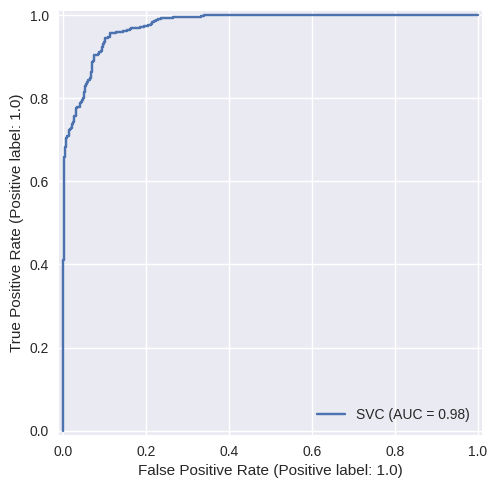

In [ ]:
# Plot ROC Curve for the test set
RocCurveDisplay.from_estimator(best_model, X_test_rfe, y_test)
plt.show()

Save the selected features

In [ ]:
# Extract selected feature names
selected_features = X_train.columns[rfe.support_]

# Create a new DataFrame with only the selected features
apple_selected_features = apple_new[selected_features]
apple_selected_features['Target'] = y

apple_selected_features

,open,daily_returns,open_tech,ADX_14,ADXR_14_2,DMN_14,ALPHATl_14_1_50_2,AO_5_34,ATRr_14,BIAS_SMA_26,CCI_14_0.015,CMF_20,CMO_14,COPC_11_14_10,CUBE_3.0_-1,...,RSI_14,RSX_14,SINWMA_14,SLOPE_1,SMA_10,SMCbi_14_50_20_5,SMI_5_20_5_1.0,SMIo_5_20_5_1.0,SQZ_NO,SQZPRO_NO,THERMO_20_2_0.5,THERMOma_20_2_0.5,VWMA_10,TSVr_18_10,Target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.98554,-0.000724,0.98554,0.000000,0.000000,0.000000,0.000000,3.977512e+08,-0.235776,-0.235776,0.000000,0.967684,0.967684,0.967684,9.676845e-01,...,0.000000,0.000000,0.000000,0.00000,0.000000,-0.01697,0.000000,0.000000,1.0,1.0,0.00000,0.000000,0.979777,0.979777,0.0
2004-11-18,0.96964,0.008925,0.96964,0.000000,0.000000,0.000000,0.000000,8.569008e+08,0.939672,0.939672,0.000000,0.956196,0.956196,0.956196,9.561956e-01,...,0.008750,0.008750,0.008750,0.00875,0.000000,-0.01697,0.000000,0.000000,1.0,1.0,0.00125,0.000000,0.984465,0.984465,1.0
2004-11-19,0.99089,-0.003973,0.99089,0.000000,0.000000,0.000000,0.000000,9.162160e+07,-0.132667,-0.132667,0.000000,1.314876,1.314876,1.314876,1.314876e+00,...,-0.003930,-0.003930,-0.003930,-0.00393,0.000000,-0.01697,0.000000,0.000000,1.0,1.0,0.02607,0.000000,0.989955,0.989955,0.0
2004-11-22,1.10357,0.112020,1.10357,0.000000,0.000000,0.000000,0.000000,2.659832e+09,-0.073717,-0.073717,0.000000,1.309734,1.309734,1.309734,1.309734e+00,...,0.110360,0.110360,0.110360,0.11036,0.000000,0.04375,0.000000,0.000000,1.0,1.0,0.12661,0.000000,1.091967,1.091967,1.0
2004-11-23,1.11250,-0.001305,1.11250,1.028860,1.028860,1.028860,0.000000,1.748382e+09,0.920993,-0.735600,0.000000,1.496213,1.496213,1.496213,1.496213e+00,...,-0.001430,-0.001430,-0.001430,-0.00143,0.000000,0.07393,0.000000,0.000000,1.0,1.0,0.05625,0.000000,1.098395,1.098395,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23,227.34000,-0.007581,227.34000,15.067168,15.037880,17.044014,221.672931,2.134353e+00,5.072199,0.010017,117.745517,-0.077989,12.034125,-1.596941,1.175437e+07,...,56.017063,52.219770,221.502595,-1.73000,222.538000,-4.01001,0.114749,0.087321,0.0,0.0,3.64000,3.535053,224.585169,0.701712,0.0
2024-09-24,228.64999,0.003974,228.64999,14.887297,15.064546,15.906585,222.437632,3.855002e+00,4.968471,0.013802,100.570243,-0.103624,14.589196,0.032944,1.159996e+07,...,57.294598,55.697836,221.926519,0.90000,223.264000,-7.36000,0.135178,0.071834,0.0,0.0,0.09999,3.207904,225.044456,0.239475,1.0
2024-09-25,224.92999,-0.004398,224.92999,14.332922,14.700045,16.480400,222.437632,4.501001e+00,4.852866,0.009260,60.607679,-0.105136,10.740296,1.225535,1.177765e+07,...,55.370148,57.821777,222.424019,-1.00000,223.635000,-5.43000,0.131616,0.045514,0.0,0.0,2.06002,3.098582,225.256877,1.240096,0.0


# **Using SOM for further dimentionality reduction**

In [ ]:
# Set seed for reproducibility
random.seed(2024)
np.random.seed(2024)

In [ ]:
# Define feature matrix X (excluding the 'Target' column)
X_som = apple_selected_features.drop(columns=['Target'])

# Transform feature matrix using MinMaxScaler
scaler = MinMaxScaler()
X_som_scaled = scaler.fit_transform(X_som)

# Convert target to integer type if it's float
target = apple_selected_features['Target'].astype(int).values

In [ ]:
# Define the size of the SOM grid
som_size_x = 20
som_size_y = 20

print(f"SOM Grid Size: {som_size_x}x{som_size_y}")

SOM Grid Size: 20x20


In [ ]:
# Initialize the SOM
som = MiniSom(x=som_size_x, y=som_size_y, input_len=X_som_scaled.shape[1], sigma=5.0, learning_rate=0.5, random_seed=42)

# Train the SOM
som.train_random(data=X_som_scaled, num_iteration=1000)

Plotting U-Matrix to visualize the clusters

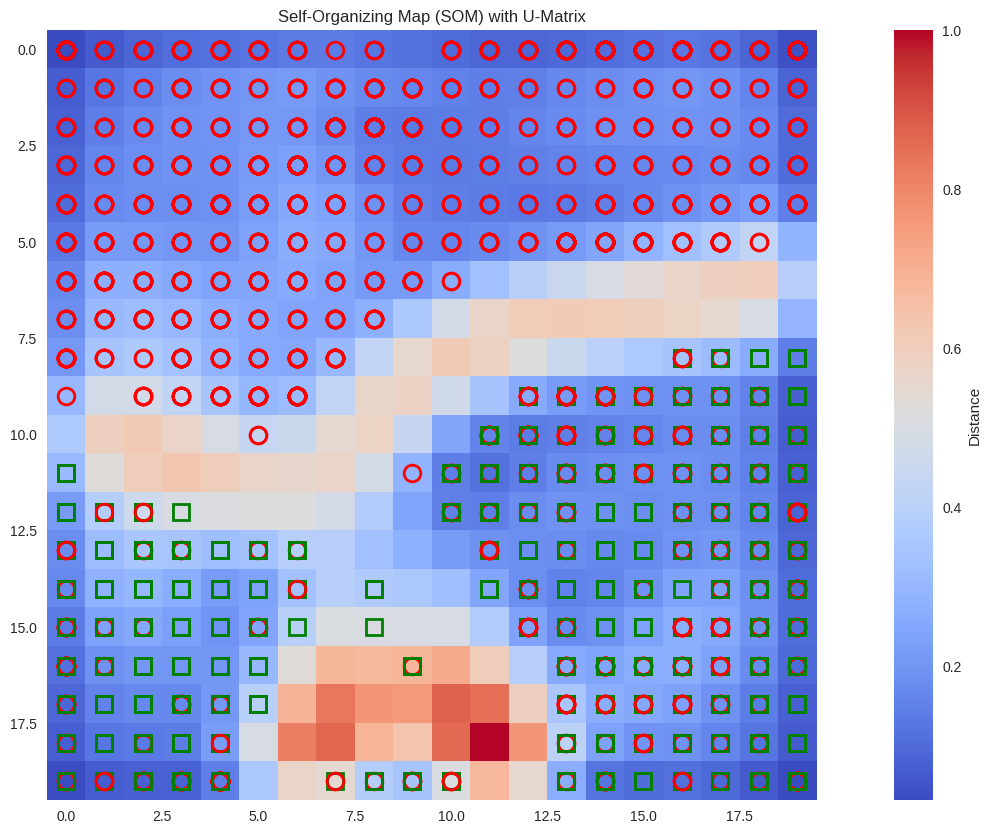

In [ ]:
# Create a U-Matrix (Unified Distance Matrix) to visualize the clusters
u_matrix = som.distance_map().T

# Plot the U-Matrix
plt.figure(figsize=(20, 10))
plt.imshow(u_matrix, cmap='coolwarm')
plt.colorbar(label='Distance')

# Overlay markers on U-Matrix with labels
markers = ['o', 's']
colors = ['r', 'g']

for i, x in enumerate(X_som_scaled):
    w = som.winner(x)
    plt.plot(w[0], w[1], markers[int(target[i])],
             markerfacecolor='None', markeredgecolor=colors[int(target[i])], markersize=12, markeredgewidth=2)

plt.title('Self-Organizing Map (SOM) with U-Matrix')
plt.grid(False)
plt.show()

Removing overlapping features

In [ ]:
# Create a dictionary to store features mapped to each neuron
neuron_mapping = defaultdict(list)

# Get the SOM weights
som_weights = som.get_weights()

# Loop over each feature (column) and map it to the corresponding neuron
for ix in range(X_som_scaled.shape[1]):  # Loop over each feature
    # Get the weight vector associated with the current feature
    weight_vector = som_weights[:, :, ix].flatten()

    # Find the neuron where this feature weight vector has the minimum distance
    winner = np.unravel_index(weight_vector.argmin(), som_weights.shape[:2])

    # Get the feature name
    feature_name = apple_selected_features.columns[ix]

    # Map the feature to the winning neuron
    neuron_mapping[winner].append(feature_name)

# Print the features that map to each neuron
for neuron, features in neuron_mapping.items():
    print(f"Neuron {neuron} has features: {features}")

# Optionally, identify neurons with overlapping features
print("\nOverlapping features (mapped to the same neuron):")
for neuron, features in neuron_mapping.items():
    if len(features) > 1:  # Check if more than one feature is mapped to the same neuron
        print(f"Neuron {neuron} has overlapping features: {features}")

Neuron (9, 19) has features: ['open', 'open_tech', 'ADX_14', 'ADXR_14_2', 'ALPHATl_14_1_50_2', 'CUBE_3.0_-1', 'CUBEs_3.0_-1', 'HMA_10', 'ISA_9', 'INVFISHER_1.0', 'INVFISHERs_1.0', 'PDIST', 'PIVOTS_TRAD_D_S1', 'PIVOTS_TRAD_D_R1', 'QTL_30_0.5', 'SINWMA_14', 'THERMO_20_2_0.5', 'THERMOma_20_2_0.5', 'VWMA_10']
Neuron (0, 6) has features: ['daily_returns', 'PCTRET_1']
Neuron (19, 18) has features: ['DMN_14']
Neuron (19, 3) has features: ['AO_5_34']
Neuron (15, 13) has features: ['ATRr_14']
Neuron (0, 10) has features: ['BIAS_SMA_26', 'COPC_11_14_10', 'EFI_13']
Neuron (3, 5) has features: ['CCI_14_0.015']
Neuron (0, 3) has features: ['CMF_20']
Neuron (0, 9) has features: ['CMO_14', 'ROC_10', 'SMI_5_20_5_1.0']
Neuron (0, 11) has features: ['BEARP_13', 'KVOs_34_55_13']
Neuron (3, 0) has features: ['INC_1']
Neuron (0, 0) has features: ['KURT_30']
Neuron (0, 19) has features: ['MAMA_0.5_0.05']
Neuron (16, 13) has features: ['FAMA_0.5_0.05']
Neuron (0, 5) has features: ['PGO_14']
Neuron (4, 4) has

In [ ]:
features_to_remove = ['open_tech', 'ADX_14', 'ALPHATl_14_1_50_2', 'CUBE_3.0_-1', 'CUBEs_3.0_-1',
                      'INVFISHER_1.0', 'PIVOTS_TRAD_D_S1', 'PIVOTS_TRAD_D_R1', 'THERMO_20_2_0.5', 'THERMOma_20_2_0.5',
                      'PCTRET_1', 'COPC_11_14_10', 'EFI_13', 'CMO_14', 'SMI_5_20_5_1.0', 'QS_10', 'RSX_14',
                      'BEARP_13', 'SQZ_NO', 'PDIST']

# Remove the selected features from the dataset
final_dataset = apple_selected_features.drop(columns=features_to_remove)

In [ ]:
final_dataset.columns

Index(['open', 'daily_returns', 'ADXR_14_2', 'DMN_14', 'AO_5_34', 'ATRr_14',
       'BIAS_SMA_26', 'CCI_14_0.015', 'CMF_20', 'HMA_10', 'ISA_9',
       'INVFISHERs_1.0', 'INC_1', 'KURT_30', 'KVOs_34_55_13', 'MAMA_0.5_0.05',
       'FAMA_0.5_0.05', 'PGO_14', 'PVI', 'QTL_30_0.5', 'ROC_10', 'RSI_14',
       'SINWMA_14', 'SLOPE_1', 'SMA_10', 'SMCbi_14_50_20_5', 'SMIo_5_20_5_1.0',
       'SQZPRO_NO', 'VWMA_10', 'TSVr_18_10', 'Target'],
      dtype='object')

In [ ]:
final_dataset.describe()

,open,daily_returns,ADXR_14_2,DMN_14,AO_5_34,ATRr_14,BIAS_SMA_26,CCI_14_0.015,CMF_20,HMA_10,ISA_9,INVFISHERs_1.0,INC_1,KURT_30,KVOs_34_55_13,...,FAMA_0.5_0.05,PGO_14,PVI,QTL_30_0.5,ROC_10,RSI_14,SINWMA_14,SLOPE_1,SMA_10,SMCbi_14_50_20_5,SMIo_5_20_5_1.0,SQZPRO_NO,VWMA_10,TSVr_18_10,Target
count,4999.000000,4999.000000,4999.000000,4999.000000,4.999000e+03,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4.999000e+03,...,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000,4999.000000
mean,50.537535,0.001299,27.183280,3.811885,2.960907e+07,1.164080,0.013311,24.338647,0.080439,50.555465,49.003753,-0.269708,0.529506,-0.303991,-1.050485e+05,...,50.254144,0.399307,100.026412,49.908860,1.267449,55.354185,50.275650,0.045371,50.365730,-0.967146,0.004959,0.004001,50.345972,0.847640,0.445289
std,60.086854,0.020424,10.642779,5.321924,3.909812e+08,1.461391,0.067788,108.443856,1.061988,60.130049,58.445951,0.243891,0.499179,14.181329,2.867099e+07,...,61.036009,1.576475,1.676369,59.400622,6.279520,13.350404,59.805984,1.364867,59.901125,2.317999,0.100860,0.063132,59.887672,25.770957,0.497047
min,0.969640,-0.179194,0.000000,0.000000,-1.756850e+01,-0.235776,-1.000000,-359.820047,-0.399211,0.980360,1.105265,-0.462101,0.000000,-1.979265,-1.757986e+08,...,0.981204,-5.637985,82.080568,-5.000000,-32.737028,-0.046080,-0.046080,-10.590000,0.000000,-28.480000,-0.289640,0.000000,0.979777,-994.955329,0.000000
25%,6.978215,-0.008378,19.194781,0.567902,-2.376570e-01,0.209912,-0.020139,-62.998807,-0.061421,6.936747,6.606604,-0.441758,0.000000,-1.111915,-7.288959e+06,...,6.912439,-0.680665,100.000000,6.784820,-2.450094,45.610801,6.950776,-0.152500,6.957036,-0.947680,-0.042925,0.000000,6.947526,0.366183,0.000000
50%,24.285360,0.001008,25.760784,1.490466,2.071281e-01,0.453331,0.017463,43.344676,0.041183,24.275737,24.126875,-0.380193,1.000000,-0.710593,4.233237e+05,...,24.232242,0.436905,100.000000,24.168750,1.398455,55.616567,24.252135,0.011610,24.290250,-0.247500,0.003683,0.000000,24.258750,0.940976,0.000000
75%,57.380000,0.011741,33.438460,4.299715,1.258313e+00,1.333887,0.052586,107.771940,0.149906,57.531841,55.161563,-0.253018,1.000000,-0.152529,7.524186e+06,...,55.884808,1.442578,100.000000,55.696875,5.261938,65.243826,56.329609,0.225720,56.484000,-0.024285,0.047431,0.000000,56.516677,1.470075,1.000000
max,236.480000,0.139051,69.296113,36.371373,6.994557e+09,6.920489,0.939672,368.904244,35.118707,233.970644,225.830000,1.000000,1.000000,1000.000000,1.360489e+08,...,1000.000000,6.925915,111.829888,226.210000,29.768601,90.402107,229.172321,14.029990,229.620999,11.595000,1.153599,1.000000,229.541723,872.347685,1.000000


In [ ]:
final_dataset.shape

(4999, 31)

# **Outlier detection using Z-score**

In [ ]:
# Calculate Z-scores for each column
z_scores = np.abs(stats.zscore(final_dataset.select_dtypes(include=[np.number])))

# Set a threshold and find outliers
threshold = 3
outliers = np.where(z_scores > threshold)

# Print out the number of outliers for each feature
print(f"Number of outliers detected: {len(outliers[0])}")

Number of outliers detected: 999


#### **Using IQR to handle outliers**

In [ ]:
# Select only numeric columns
numeric_df = final_dataset.select_dtypes(include=[np.number])

# Calculate Q1 (25th percentile) and Q3 (75th percentile)
Q1 = numeric_df.quantile(0.25)
Q3 = numeric_df.quantile(0.75)

# Calculate the IQR (Interquartile Range)
IQR = Q3 - Q1

In [ ]:
# Identify outliers using the IQR method
outliers = ((numeric_df < (Q1 - 1.5 * IQR)) | (numeric_df > (Q3 + 1.5 * IQR)))

# Optionally, print outliers or take further action
print(outliers.sum())  # Count of outliers in each column

# Capping outliers to the lower and upper bounds of the IQR
df_capped = numeric_df.copy()
for col in numeric_df.columns:
    lower_bound = Q1[col] - 1.5 * IQR[col]
    upper_bound = Q3[col] + 1.5 * IQR[col]
    df_capped[col] = np.where(numeric_df[col] < lower_bound, lower_bound, numeric_df[col])
    df_capped[col] = np.where(df_capped[col] > upper_bound, upper_bound, df_capped[col])

open                 838
daily_returns        277
ADXR_14_2             98
DMN_14               649
AO_5_34             1073
ATRr_14              805
BIAS_SMA_26          100
CCI_14_0.015           5
CMF_20                25
HMA_10               833
ISA_9                868
INVFISHERs_1.0       930
INC_1                  0
KURT_30              218
KVOs_34_55_13        871
MAMA_0.5_0.05        833
FAMA_0.5_0.05        876
PGO_14                40
PVI                 2372
QTL_30_0.5           868
ROC_10               101
RSI_14                13
SINWMA_14            863
SLOPE_1             1105
SMA_10               859
SMCbi_14_50_20_5     793
SMIo_5_20_5_1.0       67
SQZPRO_NO             20
VWMA_10              856
TSVr_18_10           757
Target                 0
dtype: int64


#### **Key Pair Plot**

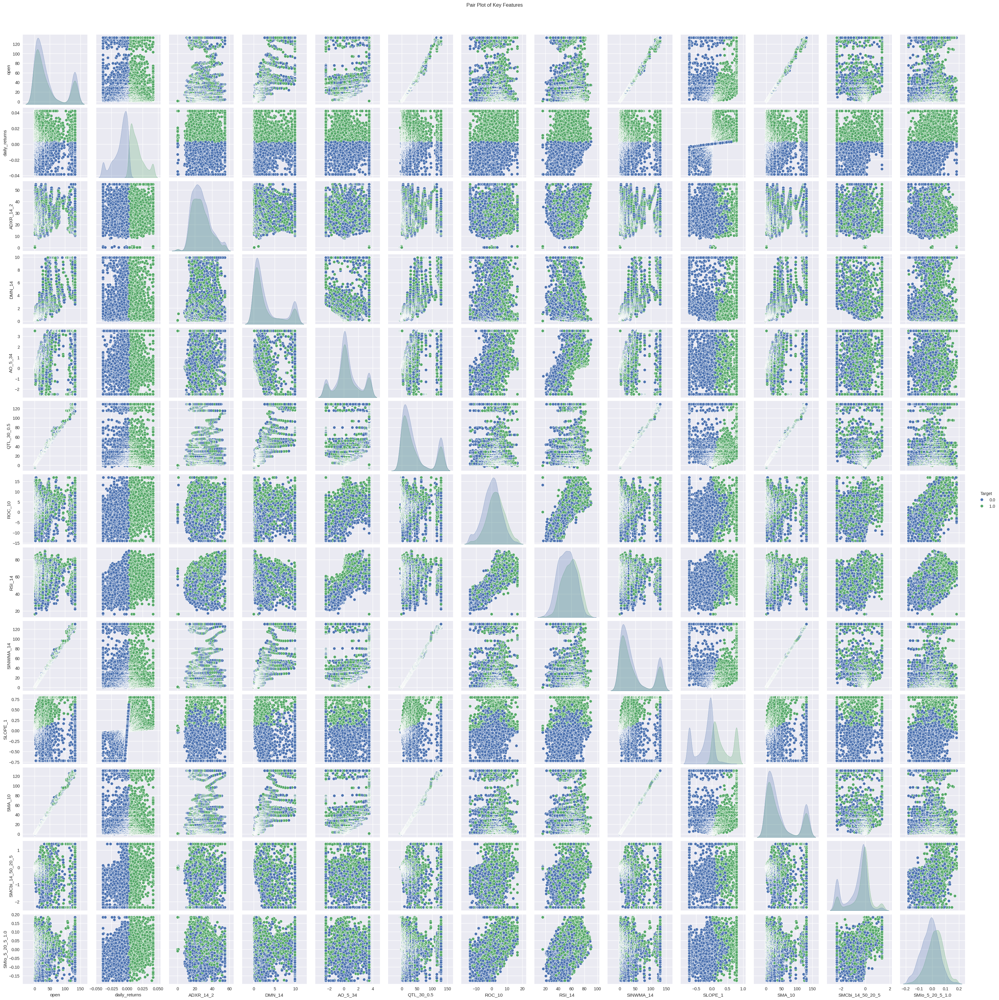

In [ ]:
# Selecting a subset of relevant features for the pair plot
selected_features_for_plot = [
    'open', 'daily_returns', 'ADXR_14_2', 'DMN_14', 'AO_5_34','QTL_30_0.5', 'ROC_10', 'RSI_14',
       'SINWMA_14', 'SLOPE_1', 'SMA_10', 'SMCbi_14_50_20_5', 'SMIo_5_20_5_1.0', 'Target'
       ]

# Create a pairplot
sns.pairplot(df_capped[selected_features_for_plot], hue='Target' ,diag_kind='kde')
plt.suptitle('Pair Plot of Key Features', y=1.02)
plt.show()

# **Checking Feature importance using RandomForest**


In [ ]:
# Assuming your final dataset is stored in a DataFrame called `df_capped`
X = df_capped.drop('Target', axis=1)  # Features
y = df_capped['Target']  # Target variable

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Get feature importance
feature_importance = pd.Series(rf_model.feature_importances_, index=X.columns)
feature_importance = feature_importance.sort_values(ascending=False)

# Display feature importance
print("Feature Importance:")
feature_importance

Feature Importance:


,0
daily_returns,0.470623
SLOPE_1,0.294958
INC_1,0.146329
PGO_14,0.013078
CCI_14_0.015,0.010346
SMCbi_14_50_20_5,0.010268
ROC_10,0.005722
BIAS_SMA_26,0.005277
SMIo_5_20_5_1.0,0.005124
RSI_14,0.003723


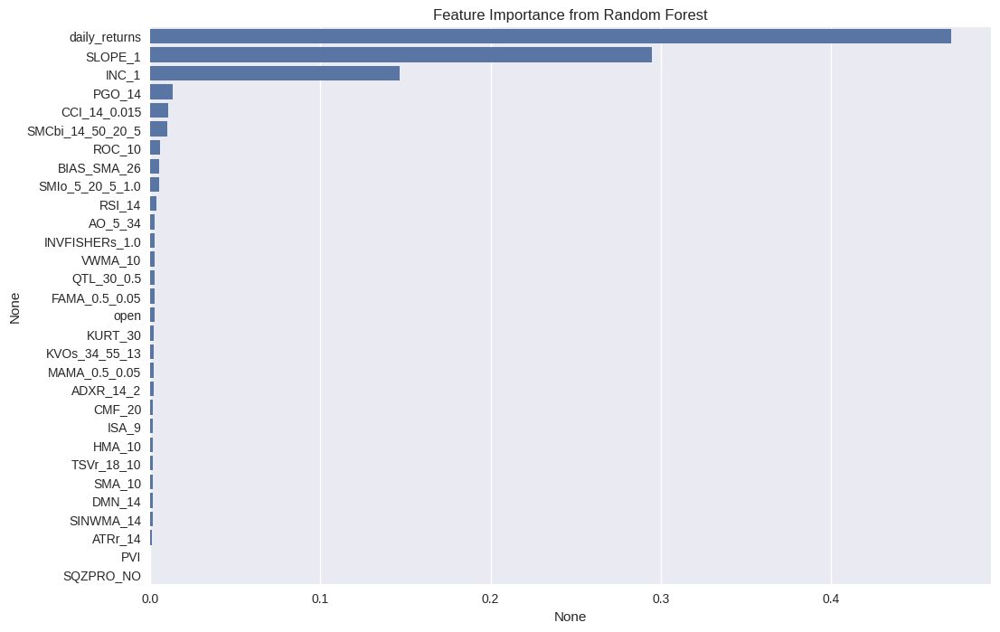

In [ ]:
# Plot feature importance
plt.figure(figsize=(12, 8))
sns.barplot(x=feature_importance, y=feature_importance.index)
plt.title("Feature Importance from Random Forest")
plt.show()

In [ ]:
df_capped.drop(columns=['PVI', 'SQZPRO_NO'], inplace=True)
df_capped

,open,daily_returns,ADXR_14_2,DMN_14,AO_5_34,ATRr_14,BIAS_SMA_26,CCI_14_0.015,CMF_20,HMA_10,ISA_9,INVFISHERs_1.0,INC_1,KURT_30,KVOs_34_55_13,MAMA_0.5_0.05,FAMA_0.5_0.05,PGO_14,QTL_30_0.5,ROC_10,RSI_14,SINWMA_14,SLOPE_1,SMA_10,SMCbi_14_50_20_5,SMIo_5_20_5_1.0,VWMA_10,TSVr_18_10,Target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.985540,-0.000724,0.000000,0.000000,3.502267,-0.235776,-0.129226,0.000000,0.466897,0.980360,1.143040,-0.462088,0.0,1.286551,1.000000e+03,132.964104,129.343361,0.020000,-0.980393,0.000000,16.161264,0.000000,0.00000,0.000000,-0.016970,0.000000,0.979777,0.979777,0.0
2004-11-18,0.969640,0.008925,0.000000,0.000000,3.502267,0.939672,0.161673,0.000000,0.466897,0.982294,1.127860,-0.462101,1.0,0.008886,8.885698e-03,0.981204,0.981204,0.979583,-0.980218,0.008750,16.161264,0.008750,0.00875,0.000000,-0.016970,0.000000,0.984465,0.984465,1.0
2004-11-19,0.990890,-0.003973,0.000000,0.000000,3.502267,-0.132667,-0.129226,0.000000,0.466897,0.983132,1.146070,-0.461730,0.0,-0.003981,-3.981183e-03,0.981596,0.981596,0.982917,-0.980296,-0.003930,16.161264,-0.003930,-0.00393,0.000000,-0.016970,0.000000,0.989955,0.989955,0.0
2004-11-22,1.103570,0.041919,0.000000,0.000000,3.502267,-0.073717,-0.073717,0.000000,0.466897,1.008257,1.150710,-0.461735,1.0,0.106178,1.061783e-01,0.988939,0.988939,0.991547,-0.978089,0.110360,16.161264,0.110360,0.11036,0.000000,0.043750,0.000000,1.091967,1.091967,1.0
2004-11-23,1.112500,-0.001305,1.028860,1.028860,3.502267,0.920993,-0.129226,0.000000,0.466897,1.030109,1.157140,-0.461567,0.0,-0.001306,-1.306145e-03,0.995959,0.995959,1.090777,-0.978118,-0.001430,16.161264,-0.001430,-0.00143,0.000000,0.073930,0.000000,1.098395,1.098395,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23,132.982677,-0.007581,15.037880,9.897436,2.134353,3.019850,0.010017,117.745517,-0.077989,133.424481,127.994001,0.030093,0.0,-0.723957,4.782087e+05,132.964104,129.343361,0.860190,129.064957,2.516862,56.017063,130.397859,-0.71983,130.774445,-2.332772,0.087321,130.870402,0.701712,0.0
2024-09-24,132.982677,0.003974,15.064546,9.897436,3.502267,3.019850,0.013802,100.570243,-0.103624,133.424481,127.994001,0.030093,1.0,-0.538729,1.193033e+06,132.964104,129.343361,0.947862,129.064957,3.298351,57.294598,130.397859,0.79305,130.774445,-2.332772,0.071834,130.870402,0.239475,1.0
2024-09-25,132.982677,-0.004398,14.700045,9.897436,3.502267,3.019850,0.009260,60.607679,-0.105136,133.424481,127.994001,0.030093,0.0,-0.380804,1.576230e+06,132.964104,129.343361,0.693424,129.064957,1.666218,55.370148,130.397859,-0.71983,130.774445,-2.332772,0.045514,130.870402,1.240096,0.0


<hr>

# **Importing Addictional Libraries**

In [ ]:
!pip install quantstats

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.5/45.5 kB 858.1 kB/s eta 0:00:00


In [ ]:
from pathlib import Path
import pydot

from sklearn.metrics import mean_squared_error, r2_score
from sklearn.utils import class_weight

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Dropout, Flatten, GRU
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from tensorflow.keras.metrics import Metric, BinaryAccuracy, Precision, Recall, AUC, TruePositives, TrueNegatives, FalsePositives, FalseNegatives

import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8')
from pprint import pprint

# Keras Tuner for hyperparameter optimization
import keras_tuner as kt

# QuantStats for backtesting report
import quantstats as qs

#### **Loading Tensorflow to log data processes**

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# **Data Handling**

In [ ]:
# Load the dataset
df = df_capped.copy()

# Convert 'date' column to datetime
df.index = pd.to_datetime(df.index)
df

,open,daily_returns,ADXR_14_2,DMN_14,AO_5_34,ATRr_14,BIAS_SMA_26,CCI_14_0.015,CMF_20,HMA_10,ISA_9,INVFISHERs_1.0,INC_1,KURT_30,KVOs_34_55_13,MAMA_0.5_0.05,FAMA_0.5_0.05,PGO_14,QTL_30_0.5,ROC_10,RSI_14,SINWMA_14,SLOPE_1,SMA_10,SMCbi_14_50_20_5,SMIo_5_20_5_1.0,VWMA_10,TSVr_18_10,Target
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-11-17,0.985540,-0.000724,0.000000,0.000000,3.502267,-0.235776,-0.129226,0.000000,0.466897,0.980360,1.143040,-0.462088,0.0,1.286551,1.000000e+03,132.964104,129.343361,0.020000,-0.980393,0.000000,16.161264,0.000000,0.00000,0.000000,-0.016970,0.000000,0.979777,0.979777,0.0
2004-11-18,0.969640,0.008925,0.000000,0.000000,3.502267,0.939672,0.161673,0.000000,0.466897,0.982294,1.127860,-0.462101,1.0,0.008886,8.885698e-03,0.981204,0.981204,0.979583,-0.980218,0.008750,16.161264,0.008750,0.00875,0.000000,-0.016970,0.000000,0.984465,0.984465,1.0
2004-11-19,0.990890,-0.003973,0.000000,0.000000,3.502267,-0.132667,-0.129226,0.000000,0.466897,0.983132,1.146070,-0.461730,0.0,-0.003981,-3.981183e-03,0.981596,0.981596,0.982917,-0.980296,-0.003930,16.161264,-0.003930,-0.00393,0.000000,-0.016970,0.000000,0.989955,0.989955,0.0
2004-11-22,1.103570,0.041919,0.000000,0.000000,3.502267,-0.073717,-0.073717,0.000000,0.466897,1.008257,1.150710,-0.461735,1.0,0.106178,1.061783e-01,0.988939,0.988939,0.991547,-0.978089,0.110360,16.161264,0.110360,0.11036,0.000000,0.043750,0.000000,1.091967,1.091967,1.0
2004-11-23,1.112500,-0.001305,1.028860,1.028860,3.502267,0.920993,-0.129226,0.000000,0.466897,1.030109,1.157140,-0.461567,0.0,-0.001306,-1.306145e-03,0.995959,0.995959,1.090777,-0.978118,-0.001430,16.161264,-0.001430,-0.00143,0.000000,0.073930,0.000000,1.098395,1.098395,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-09-23,132.982677,-0.007581,15.037880,9.897436,2.134353,3.019850,0.010017,117.745517,-0.077989,133.424481,127.994001,0.030093,0.0,-0.723957,4.782087e+05,132.964104,129.343361,0.860190,129.064957,2.516862,56.017063,130.397859,-0.71983,130.774445,-2.332772,0.087321,130.870402,0.701712,0.0
2024-09-24,132.982677,0.003974,15.064546,9.897436,3.502267,3.019850,0.013802,100.570243,-0.103624,133.424481,127.994001,0.030093,1.0,-0.538729,1.193033e+06,132.964104,129.343361,0.947862,129.064957,3.298351,57.294598,130.397859,0.79305,130.774445,-2.332772,0.071834,130.870402,0.239475,1.0
2024-09-25,132.982677,-0.004398,14.700045,9.897436,3.502267,3.019850,0.009260,60.607679,-0.105136,133.424481,127.994001,0.030093,0.0,-0.380804,1.576230e+06,132.964104,129.343361,0.693424,129.064957,1.666218,55.370148,130.397859,-0.71983,130.774445,-2.332772,0.045514,130.870402,1.240096,0.0


In [ ]:
df.dtypes

,0
open,float64
daily_returns,float64
ADXR_14_2,float64
DMN_14,float64
AO_5_34,float64
ATRr_14,float64
BIAS_SMA_26,float64
CCI_14_0.015,float64
CMF_20,float64
HMA_10,float64


In [ ]:
# Set the target variable
y = df['Target'].values
X = df.drop(columns=['Target']).values

In [ ]:
#Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

#### **Handling Class Imbalance by Calculating Class Weights**

In [ ]:
#Handle Class Imbalance
y_int = y_train.astype(int)
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_int), y=y_int)
class_weight_dict = {i: class_weights[i] for i in range(len(class_weights))}

# Verify the weighted balance
c = np.bincount(y_int)
print(f"Class frequencies: {c}")
print(f"Weighted balance: {class_weight_dict[0] * c[0]}, {class_weight_dict[1] * c[1]}")

Class frequencies: [2204 1795]
Weighted balance: 1999.5, 1999.5000000000002


#### **Feature Scaling**

In [ ]:
#Scale the Features
scaler = MinMaxScaler()

# Fit on the training data and transform it
X_train_scaled = scaler.fit_transform(X_train)

# Transform the test data using the scaler fitted on the training data
X_test_scaled = scaler.transform(X_test)

# Verify the scaled data
print(f"Scaled Training Data: {X_train_scaled.shape}, Scaled Test Data: {X_test_scaled.shape}")

Scaled Training Data: (3999, 28), Scaled Test Data: (1000, 28)


#### **Defining Lookback and Aligning Data Lengths**

In [ ]:
# Define the Sequence Length (lookback period)
lookback = 21

# Adjust Data Lengths to Ensure Alignment
min_samples_train = min(X_train_scaled.shape[0] - lookback + 1, y_train.shape[0])
min_samples_test = min(X_test_scaled.shape[0] - lookback + 1, y_test.shape[0])

X_train_scaled = X_train_scaled[:min_samples_train + lookback - 1]
y_train = y_train[:min_samples_train]

X_test_scaled = X_test_scaled[:min_samples_test + lookback - 1]
y_test = y_test[:min_samples_test]

# Ensure both X and y have the same length
if X_train_scaled.shape[0] > y_train.shape[0]:
    X_train_scaled = X_train_scaled[-y_train.shape[0]:]
elif y_train.shape[0] > X_train_scaled.shape[0]:
    y_train = y_train[-X_train_scaled.shape[0]:]

if X_test_scaled.shape[0] > y_test.shape[0]:
    X_test_scaled = X_test_scaled[-y_test.shape[0]:]
elif y_test.shape[0] > X_test_scaled.shape[0]:
    y_test = y_test[-X_test_scaled.shape[0]:]

#### **Generating Sequence Data Using TimeseriesGenerator**

In [ ]:
# Generate Sequences Using TimeseriesGenerator
train_generator = TimeseriesGenerator(X_train_scaled, y_train, length=lookback, batch_size=32)
test_generator = TimeseriesGenerator(X_test_scaled, y_test, length=lookback, batch_size=32)


# Confirm the dimensions of the generated data
for i in range(len(train_generator)):
    X, y = train_generator[i]
    print(f"Generated sequence {i} - X shape: {X.shape}, y shape: {y.shape}")
    if i == 5:
        break

for i in range(len(test_generator)):
    try:
        X, y = test_generator[i]
        print(f"Generated sequence {i} - X shape: {X.shape}, y shape: {y.shape}")
    except KeyError as e:
        print(f"Error at sequence {i}: {e}")

Generated sequence 0 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 1 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 2 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 3 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 4 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 5 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 0 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 1 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 2 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 3 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 4 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 5 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 6 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 7 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 8 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 9 - X shape: (32, 21, 28), y shape: (32,)
Generated sequence 10 - 

# **Building the Models**

# **1. LSTM**

In [ ]:
# Build the 5-Layer LSTM Model with Hyperparameter Tuning
def build_model(hp):
    tf.keras.backend.clear_session()

    model = Sequential()

    # First LSTM Layer
    hp_units1 = hp.Int('units1', min_value=4, max_value=64, step=4)
    hp_dropout1 = hp.Float('dropout_rate1', min_value=0.0, max_value=0.5, step=0.1)
    model.add(LSTM(units=hp_units1, input_shape=(lookback, X_train_scaled.shape[1]), activation='relu', return_sequences=True))
    model.add(Dropout(hp_dropout1))

    # Second to Fifth LSTM Layers
    for i in range(2, 6):
        hp_units = hp.Int(f'units{i}', min_value=4, max_value=64, step=4)
        hp_dropout = hp.Float(f'dropout_rate{i}', min_value=0.0, max_value=0.5, step=0.1)
        model.add(LSTM(units=hp_units, activation='relu', return_sequences=True if i < 5 else False))
        model.add(Dropout(hp_dropout))

    # Output Layer
    model.add(Dense(1, activation='sigmoid'))

    # Compile the Model
    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4]), epsilon=1e-08, decay=0.0),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

    return model

#### **RandomSearch Tuner for LSTM**

In [ ]:
# Setup RandomSearch Tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',  # Use loss as the primary metric
    max_trials=15,  # Maximum number of trials
    directory='./keras',
    project_name='rs_5layer_lstm',  #to distinguish between trials
    overwrite=True
)

#### **Callbacks for Early Stopping and Tensorboard**

In [ ]:
# Setup Callbacks for Early Stopping and TensorBoard
log_dir = "./logs/5_layer_lstm"
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, mode='min', verbose=1)

callbacks = [early_stopping, tensorboard_callback]

#### **Hyperparametric Tuning using RandomSearch**

In [ ]:
# Perform the Hyperparameter Search
tuner.search(train_generator, epochs=100, validation_data=test_generator, class_weight=class_weight_dict, callbacks=callbacks)

Trial 15 Complete [00h 01m 35s]
val_loss: 0.6912727355957031

Best val_loss So Far: 0.03678018972277641
Total elapsed time: 00h 51m 52s


In [ ]:
# Retrieve the Best Hyperparameters
best_hbp = tuner.get_best_hyperparameters()[0]
print(best_hbp.values)

{'units1': 24, 'dropout_rate1': 0.2, 'units2': 8, 'dropout_rate2': 0.2, 'units3': 48, 'dropout_rate3': 0.2, 'units4': 4, 'dropout_rate4': 0.4, 'units5': 8, 'dropout_rate5': 0.30000000000000004, 'learning_rate': 0.001}


In [ ]:
# Display tuning results summary
tuner.results_summary()

Results summary
Results in ./keras/rs_5layer_lstm
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 13 summary
Hyperparameters:
units1: 24
dropout_rate1: 0.2
units2: 8
dropout_rate2: 0.2
units3: 48
dropout_rate3: 0.2
units4: 4
dropout_rate4: 0.4
units5: 8
dropout_rate5: 0.30000000000000004
learning_rate: 0.001
Score: 0.03678018972277641

Trial 03 summary
Hyperparameters:
units1: 32
dropout_rate1: 0.2
units2: 32
dropout_rate2: 0.30000000000000004
units3: 56
dropout_rate3: 0.2
units4: 40
dropout_rate4: 0.4
units5: 32
dropout_rate5: 0.30000000000000004
learning_rate: 0.001
Score: 0.07019162178039551

Trial 11 summary
Hyperparameters:
units1: 60
dropout_rate1: 0.0
units2: 64
dropout_rate2: 0.1
units3: 60
dropout_rate3: 0.2
units4: 24
dropout_rate4: 0.30000000000000004
units5: 52
dropout_rate5: 0.2
learning_rate: 0.001
Score: 0.07272011041641235

Trial 10 summary
Hyperparameters:
units1: 20
dropout_rate1: 0.4
units2: 4
dropout_rate2: 0.2
units3: 20
dropout_rate3: 0.1

In [ ]:
# Evaluate the Best Model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.evaluate(test_generator)

# Evaluate the model on the test data
loss, accuracy, precision, recall = best_model.evaluate(test_generator)

# Calculate F1 Score
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1_score:.4f}")

30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.9920 - loss: 0.0296 - precision: 0.9887 - recall: 0.9927
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.9920 - loss: 0.0296 - precision: 0.9887 - recall: 0.9927
Accuracy: 0.9875
Precision: 0.9833
Recall: 0.9880
F1 Score: 0.9856


In [ ]:
best_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 21, 24)              │           5,088 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 21, 24)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 21, 8)               │           1,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 21, 8)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_2 (LSTM)                        │ (None, 21, 48)              │          10,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 21, 48)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 21, 4)               │             848 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 21, 4)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_4 (LSTM)                        │ (None, 8)                   │             416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 8)                   │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │               9 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,361 (71.72 KB)

 Trainable params: 18,361 (71.72 KB)

 Non-trainable params: 0 (0.00 B)

#### **Generating Predictions**

In [ ]:
# Generate predictions using the test data
predictions = best_model.predict(test_generator)
predictions = (predictions > 0.5).astype(int)  # Convert probabilities to binary 0 or 1

# Actual values from the test data
actual = y_test[-len(predictions):]  # Ensure the length matches the predictions

# Combine predictions and actual values into a DataFrame
comparison_df = pd.DataFrame({
    'Predicted': predictions.flatten(),
    'Actual': actual
})

# Display the first few rows of the comparison DataFrame
print(comparison_df.head(20))

30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 52ms/step
    Predicted  Actual
0           1     1.0
1           0     0.0
2           0     0.0
3           0     0.0
4           1     1.0
5           0     0.0
6           0     0.0
7           1     1.0
8           0     0.0
9           0     0.0
10          1     1.0
11          0     0.0
12          0     0.0
13          1     1.0
14          1     1.0
15          1     1.0
16          1     1.0
17          1     1.0
18          0     0.0
19          0     0.0


In [ ]:
# Save the best model
best_model.save("best_5_layer_lstm_model.keras")

In [ ]:
#Launch TensorBoard
%tensorboard --logdir=./logs/5_layer_lstm

<IPython.core.display.Javascript object>

# **2. GRU Model**

In [ ]:
# Build the GRU Model with Hyperparameter Tuning
def build_model(hp):
    tf.keras.backend.clear_session()

    # Instantiate the model
    model = Sequential()

    # Tune the number of units for the first GRU layer
    hp_units1 = hp.Int('units1', min_value=4, max_value=64, step=4)
    # Tune the dropout rate for the first GRU layer
    hp_dropout1 = hp.Float('dropout_rate1', min_value=0.0, max_value=0.5, step=0.1)

    # Add the first GRU layer
    model.add(GRU(units=hp_units1, input_shape=(lookback, X_train_scaled.shape[1]),
                  activation='relu', return_sequences=True))
    # Add Dropout after the first GRU layer
    model.add(Dropout(hp_dropout1))

    # Add a second GRU layer
    hp_units2 = hp.Int('units2', min_value=4, max_value=64, step=4)
    hp_dropout2 = hp.Float('dropout_rate2', min_value=0.0, max_value=0.5, step=0.1)
    model.add(GRU(units=hp_units2, activation='relu', return_sequences=False))
    model.add(Dropout(hp_dropout2))

    # Add output layer
    model.add(Dense(1, activation='sigmoid'))

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4]),
                                 epsilon=1e-08, decay=0.0),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

    return model

#### **RandomSearch Tuner for GRU Model**

In [ ]:
# Setup RandomSearch Tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',  # Use loss as the primary metric
    max_trials=20,  # Maximum number of trials
    directory='./keras',
    project_name='random_search_gru',  # Change this to distinguish between trials
    overwrite=True
)

#### **Callback Function**

In [ ]:
# Setup Callbacks for Early Stopping and TensorBoard
log_dir = "./logs/gru_model"
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, mode='min', verbose=1)

# Include the callbacks in the model training
callbacks = [early_stopping, tensorboard_callback]

#### **Hyperparameter Tuning**

In [ ]:
# Perform the Hyperparameter Search
tuner.search(train_generator, epochs=100, validation_data=test_generator,
             class_weight=class_weight_dict,
             callbacks=callbacks)

Trial 20 Complete [00h 00m 39s]
val_loss: 0.6869757771492004

Best val_loss So Far: 0.03399357199668884
Total elapsed time: 00h 37m 30s


In [ ]:
# Retrieve the Best Hyperparameters
best_hbp = tuner.get_best_hyperparameters()[0]
print(best_hbp.values)

{'units1': 40, 'dropout_rate1': 0.2, 'units2': 16, 'dropout_rate2': 0.1, 'learning_rate': 0.001}


In [ ]:
# Display tuning results summary
tuner.results_summary()

Results summary
Results in ./keras/random_search_gru
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 15 summary
Hyperparameters:
units1: 40
dropout_rate1: 0.2
units2: 16
dropout_rate2: 0.1
learning_rate: 0.001
Score: 0.03399357199668884

Trial 03 summary
Hyperparameters:
units1: 52
dropout_rate1: 0.0
units2: 24
dropout_rate2: 0.30000000000000004
learning_rate: 0.001
Score: 0.03430507704615593

Trial 10 summary
Hyperparameters:
units1: 28
dropout_rate1: 0.2
units2: 20
dropout_rate2: 0.0
learning_rate: 0.01
Score: 0.04037732630968094

Trial 05 summary
Hyperparameters:
units1: 12
dropout_rate1: 0.2
units2: 28
dropout_rate2: 0.4
learning_rate: 0.01
Score: 0.04204277694225311

Trial 06 summary
Hyperparameters:
units1: 32
dropout_rate1: 0.4
units2: 4
dropout_rate2: 0.30000000000000004
learning_rate: 0.01
Score: 0.04458712413907051

Trial 01 summary
Hyperparameters:
units1: 52
dropout_rate1: 0.30000000000000004
units2: 8
dropout_rate2: 0.2
learning_rate: 0.001
Score:

#### **Evaluating Best GRU model**

In [ ]:
# Evaluate the Best GRU Model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.evaluate(test_generator)

# Evaluate the model on the test data
loss, accuracy, precision, recall = best_model.evaluate(test_generator)

# Calculate F1 Score
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1_score:.4f}")

30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.9874 - loss: 0.0242 - precision: 0.9924 - recall: 0.9778
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9874 - loss: 0.0242 - precision: 0.9924 - recall: 0.9778
Accuracy: 0.9864
Precision: 0.9856
Recall: 0.9832
F1 Score: 0.9844


In [ ]:
best_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ gru (GRU)                            │ (None, 21, 40)              │           8,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 21, 40)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ gru_1 (GRU)                          │ (None, 16)                  │           2,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 11,201 (43.75 KB)

 Trainable params: 11,201 (43.75 KB)

 Non-trainable params: 0 (0.00 B)

#### **Generating Predictions**

In [ ]:
# Generate predictions using the test data
predictions = best_model.predict(test_generator)
predictions = (predictions > 0.5).astype(int)  # Convert probabilities to binary 0 or 1

# Actual values from the test data
actual = y_test[-len(predictions):]  # Ensure the length matches the predictions

# Combine predictions and actual values into a DataFrame
comparison_df = pd.DataFrame({
    'Predicted': predictions.flatten(),
    'Actual': actual
})

# Display the first few rows of the comparison DataFrame
print(comparison_df.head(20))

30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step
    Predicted  Actual
0           1     1.0
1           0     0.0
2           0     0.0
3           0     0.0
4           1     1.0
5           0     0.0
6           0     0.0
7           1     1.0
8           0     0.0
9           0     0.0
10          1     1.0
11          0     0.0
12          0     0.0
13          1     1.0
14          1     1.0
15          1     1.0
16          1     1.0
17          1     1.0
18          0     0.0
19          0     0.0


In [ ]:
#Save the best model
best_model.save("best_gru_model.keras")

In [ ]:
#Launch TensorBoard
%tensorboard --logdir=./logs/gru_model

<IPython.core.display.Javascript object>

# **3. LSTM + CNN(Conv1D) Hybrid Model**

In [ ]:
# Build the LSTM + CNN Model with Hyperparameter Tuning
def build_model(hp):
    tf.keras.backend.clear_session()

    # Input Layer
    inputs = Input(shape=(lookback, X_train_scaled.shape[1]))

    # CNN Layer
    hp_filters = hp.Int('filters', min_value=16, max_value=64, step=16)
    hp_kernel_size = hp.Choice('kernel_size', values=[2, 3, 4])
    hp_pool_size = hp.Choice('pool_size', values=[2, 3])
    x = Conv1D(filters=hp_filters, kernel_size=hp_kernel_size, activation='relu')(inputs)
    x = MaxPooling1D(pool_size=hp_pool_size)(x)

    # LSTM Layer
    hp_units = hp.Int('units', min_value=4, max_value=32, step=4)
    x = LSTM(units=hp_units, activation='relu', return_sequences=False)(x)

    # Dropout Layer
    hp_dropout = hp.Float('dropout_rate', min_value=0.0, max_value=0.5, step=0.1)
    x = Dropout(hp_dropout)(x)

    # Output Layer
    outputs = Dense(1, activation='sigmoid')(x)

    # Define the model
    model = Model(inputs=inputs, outputs=outputs)

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4]),
                                 epsilon=1e-08, decay=0.0),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])

    return model

#### **RandomSearch Tuner for Best params**

In [ ]:
# Setup RandomSearch Tuner
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',  # loss as the primary metric
    max_trials=20,  # Maximum number of trials
    directory='./keras',
    project_name='rs_lstm_cnn',
    overwrite=True
)

#### **Callbacks for the model**

In [ ]:
# Step 3: Setup Callbacks for Early Stopping and TensorBoard
log_dir = "./logs/lstm_cnn"
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, mode='min', verbose=1)

# Include the callbacks in the model training
callbacks = [early_stopping, tensorboard_callback]

#### **HyperParameter Search**

In [ ]:
# Perform the Hyperparameter Search
tuner.search(train_generator, epochs=100, validation_data=test_generator,
             class_weight=class_weight_dict,
             callbacks=callbacks)

Trial 20 Complete [00h 00m 31s]
val_loss: 0.6900810599327087

Best val_loss So Far: 0.20393487811088562
Total elapsed time: 00h 14m 58s


In [ ]:
# Retrieve the Best Hyperparameters
best_hbp = tuner.get_best_hyperparameters()[0]
print(best_hbp.values)

{'filters': 32, 'kernel_size': 2, 'pool_size': 2, 'units': 16, 'dropout_rate': 0.4, 'learning_rate': 0.001}


In [ ]:
# Display tuning results summary
tuner.results_summary()

Results summary
Results in ./keras/rs_lstm_cnn
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 02 summary
Hyperparameters:
filters: 32
kernel_size: 2
pool_size: 2
units: 16
dropout_rate: 0.4
learning_rate: 0.001
Score: 0.20393487811088562

Trial 09 summary
Hyperparameters:
filters: 32
kernel_size: 2
pool_size: 2
units: 16
dropout_rate: 0.1
learning_rate: 0.001
Score: 0.24959668517112732

Trial 11 summary
Hyperparameters:
filters: 64
kernel_size: 3
pool_size: 2
units: 16
dropout_rate: 0.4
learning_rate: 0.001
Score: 0.2929707467556

Trial 05 summary
Hyperparameters:
filters: 64
kernel_size: 3
pool_size: 2
units: 8
dropout_rate: 0.30000000000000004
learning_rate: 0.001
Score: 0.3029751777648926

Trial 10 summary
Hyperparameters:
filters: 16
kernel_size: 3
pool_size: 3
units: 24
dropout_rate: 0.2
learning_rate: 0.001
Score: 0.35587233304977417

Trial 12 summary
Hyperparameters:
filters: 32
kernel_size: 2
pool_size: 2
units: 32
dropout_rate: 0.4
learning_rate: 0.0

#### **Evaluate Best LSTM + CNN(Conv1D) Hybrid Model**

In [ ]:
# Evaluate the Best LSTM+CNN Model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.evaluate(test_generator)

# Evaluate the model on the test data
loss, accuracy, precision, recall = best_model.evaluate(test_generator)

# Calculate F1 Score
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1_score:.4f}")

30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9137 - loss: 0.1948 - precision: 0.8487 - recall: 0.9715
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9137 - loss: 0.1948 - precision: 0.8487 - recall: 0.9715
Accuracy: 0.9145
Precision: 0.8482
Recall: 0.9784
F1 Score: 0.9087


In [ ]:
best_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 21, 28)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d (Conv1D)                      │ (None, 20, 32)              │           1,824 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d (MaxPooling1D)         │ (None, 10, 32)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm (LSTM)                          │ (None, 16)                  │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 16)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,977 (19.44 KB)

 Trainable params: 4,977 (19.44 KB)

 Non-trainable params: 0 (0.00 B)

#### **Generate Predictions**

In [ ]:
# Generate predictions using the test data
predictions = best_model.predict(test_generator)
predictions = (predictions > 0.5).astype(int)  # Convert probabilities to binary 0 or 1

# Actual values from the test data
actual = y_test[-len(predictions):]  # Ensure the length matches the predictions

# Combine predictions and actual values into a DataFrame
comparison_df = pd.DataFrame({
    'Predicted': predictions.flatten(),
    'Actual': actual
})

# Display the first few rows of the comparison DataFrame
print(comparison_df.head(20))

30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
    Predicted  Actual
0           1     1.0
1           0     0.0
2           0     0.0
3           0     0.0
4           1     1.0
5           0     0.0
6           0     0.0
7           1     1.0
8           0     0.0
9           0     0.0
10          1     1.0
11          0     0.0
12          0     0.0
13          1     1.0
14          1     1.0
15          1     1.0
16          1     1.0
17          1     1.0
18          1     0.0
19          0     0.0


In [ ]:
#Save the best model
best_model.save("best_lstm_cnn_model.keras")

In [ ]:
#Launch TensorBoard
%tensorboard --logdir=./logs/lstm_cnn

<IPython.core.display.Javascript object>

<hr>

# **Model Evaluation**

In [ ]:
# Loading the saved models
from tensorflow.keras.models import load_model
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, recall_score
import numpy as np

# Function to calculate TPR, TNR, FPR, FNR
def calculate_tpr_tnr_fpr_fnr(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()

    tpr = tp / (tp + fn)  # True Positive Rate (Sensitivity, Recall)
    tnr = tn / (tn + fp)  # True Negative Rate (Specificity)
    fpr = fp / (fp + tn)  # False Positive Rate
    fnr = fn / (fn + tp)  # False Negative Rate

    return tpr, tnr, fpr, fnr

# Load the best models
best_5_layer_lstm_model = load_model("best_5_layer_lstm_model.keras")
best_gru_model = load_model("best_gru_model.keras")
best_lstm_cnn_model = load_model("best_lstm_cnn_model.keras")

# List of models and their names
models = [best_5_layer_lstm_model, best_gru_model, best_lstm_cnn_model]
model_names = ["5-Layers LSTM", "GRU", "LSTM + CNN (Conv1D)"]

# Dictionary to store the metrics
model_performance = {
    "Model": [],
    "Accuracy": [],
    "F1 Score": [],
    "Precision": [],
    "Recall": [],
    "TPR": [],
    "TNR": [],
    "FPR": [],
    "FNR": []
}

# Calculate metrics for each model
for model_name, model in zip(model_names, models):
    y_pred = (model.predict(test_generator) > 0.5).astype("int32")

    # Adjust y_test to match the length of y_pred
    y_test_adjusted = y_test[-len(y_pred):]

    # Calculate the metrics
    accuracy = accuracy_score(y_test_adjusted, y_pred)
    f1 = f1_score(y_test_adjusted, y_pred)
    precision = precision_score(y_test_adjusted, y_pred)
    recall = recall_score(y_test_adjusted, y_pred)
    tpr, tnr, fpr, fnr = calculate_tpr_tnr_fpr_fnr(y_test_adjusted, y_pred)

    # Store the metrics
    model_performance["Model"].append(model_name)
    model_performance["Accuracy"].append(accuracy)
    model_performance["F1 Score"].append(f1)
    model_performance["Precision"].append(precision)
    model_performance["Recall"].append(recall)
    model_performance["TPR"].append(tpr)
    model_performance["TNR"].append(tnr)
    model_performance["FPR"].append(fpr)
    model_performance["FNR"].append(fnr)

# Create a DataFrame to display the results
performance_df = pd.DataFrame(model_performance)

30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


In [ ]:
performance_df

,Model,Accuracy,F1 Score,Precision,Recall,TPR,TNR,FPR,FNR
0,5-Layers LSTM,0.987487,0.985646,0.983294,0.988010,0.988010,0.987085,0.012915,0.011990
1,GRU,0.986444,0.984394,0.985577,0.983213,0.983213,0.988930,0.011070,0.016787
2,LSTM + CNN (Conv1D),0.914494,0.908686,0.848233,0.978417,0.978417,0.865314,0.134686,0.021583


5-Layers LSTM:

    Accuracy and F1 Score: Slightly better than the 2-Layers LSTM but still lower than the Base LSTM.
    Recall: On par with the Base LSTM, indicating good sensitivity.
    TNR/FPR: Lower than the Base LSTM, with a slightly higher rate of false positives.

GRU:

    Accuracy: Comparable to the Base LSTM (0.8900).
    Precision: The highest precision (0.8898), indicating it is very good at minimizing false positives.
    Recall/TPR: Lower recall compared to the Base LSTM (0.8333).
    TNR/FPR: The best TNR (0.9290), indicating a low rate of false positives.

LSTM + CNN (Conv1D):

    Accuracy and F1 Score: The lowest among the models, but still reasonable.
    Precision: Good precision (0.7682) but lower than the Base LSTM and GRU.
    Recall: Lower recall (0.9206) compared to the Base LSTM.
    TNR/FPR: Moderate TNR and FPR, indicating some trade-off in performance.



# **Evaluating the Best Model with ROC Curve, Confusion Matrix, and Classification Report**

In [ ]:
from sklearn.metrics import roc_auc_score, confusion_matrix, classification_report, balanced_accuracy_score
from tensorflow.keras.models import load_model

# Load the best model
best_model = load_model("best_5_layer_lstm_model.keras")

# Align y_test to the length of predictions
y_test_trimmed = y_test[lookback:]

# Predicted probabilities and labels
y_pred_prob = best_model.predict(test_generator).ravel()
y_pred = (y_pred_prob > 0.5).astype("int32")

# Ensure that y_test_trimmed and y_pred_prob have the same length
print(f"y_test_trimmed length: {len(y_test_trimmed)}, y_pred_prob length: {len(y_pred_prob)}")

30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step
y_test_trimmed length: 959, y_pred_prob length: 959


#### **Confusion Matrix**

Confusion Matrix:
[[535   7]
 [  5 412]]


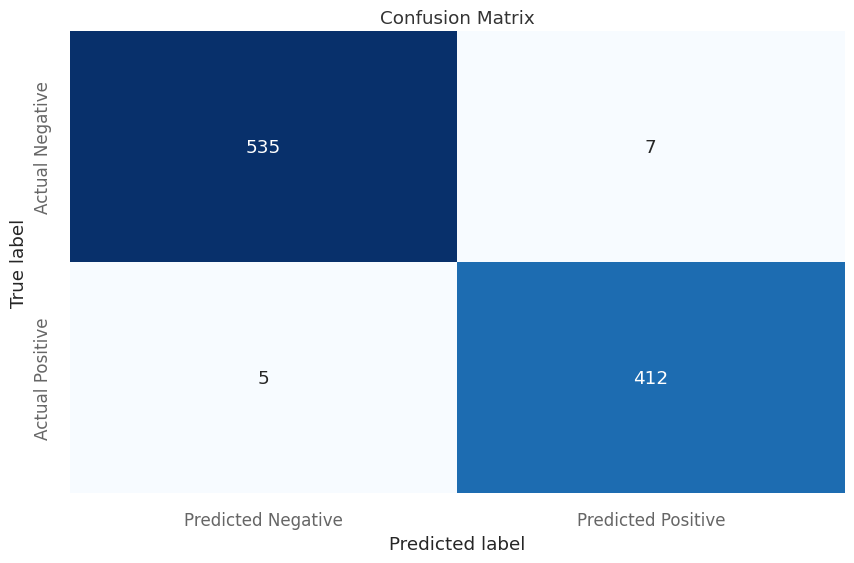

In [ ]:
# Confusion Matrix
cm = confusion_matrix(y_test_trimmed, y_pred)
print("Confusion Matrix:")
print(cm)

# Display Confusion Matrix as a nicely formatted table
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False,
            xticklabels=['Predicted Negative', 'Predicted Positive'],
            yticklabels=['Actual Negative', 'Actual Positive'])
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Confusion Matrix')
plt.show()

Interpretation of the Results:

    High True Positives (TP = 412):
        The model is highly effective at identifying uptrends, correctly predicting 412 out of the 417 actual uptrends (TP + FN). This indicates that the model is very sensitive (high recall) and is adept at capturing most of the actual positive signals.
    Low False Negatives (FN = 7):
        The model has a very low number of false negatives, meaning it rarely misses an uptrend when one actually occurs. This low number is crucial for the trading strategy as it minimizes missed opportunities.
    Moderate False Positives (FP = 5):
        There is a moderate number of false positives, where the model incorrectly predicted an uptrend when there wasn't one. In the context of trading, this could lead to entering positions that may not be profitable, which could affect overall portfolio performance.
    High True Negatives (TN = 535):
        The model also performs well in identifying periods where there is no uptrend, with 535 correct predictions out of 542 (TN + FP) actual negative instances. This helps avoid unnecessary trades, reducing the potential for losses from entering positions at the wrong time.


#### **Classification Report**

In [ ]:
# Classification Report
report = classification_report(y_test_trimmed, y_pred)
print("Classification Report:")
print(report)

Classification Report:
              precision    recall  f1-score   support

         0.0       0.99      0.99      0.99       542
         1.0       0.98      0.99      0.99       417

    accuracy                           0.99       959
   macro avg       0.99      0.99      0.99       959
weighted avg       0.99      0.99      0.99       959



#### **ROC Curve**

AUC: 0.9993


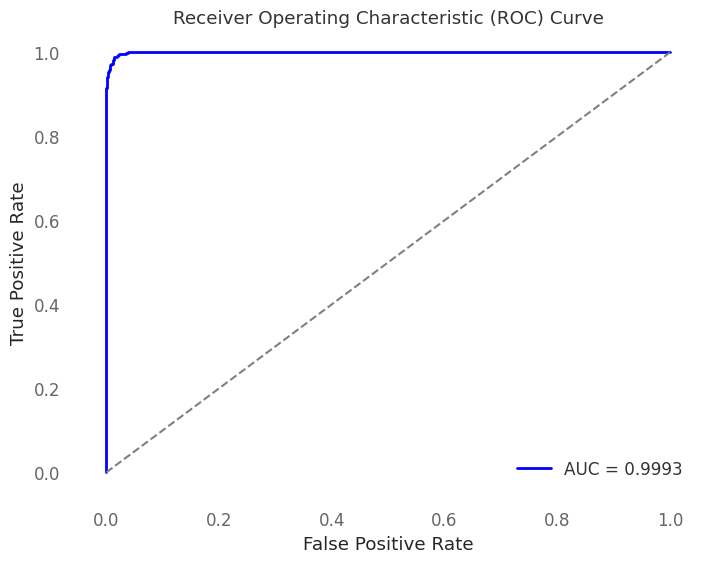

In [ ]:
# Plot ROC Curve
from sklearn.metrics import roc_curve

# AUC
auc = roc_auc_score(y_test_trimmed, y_pred_prob)
print(f"AUC: {auc:.4f}")

fpr, tpr, thresholds = roc_curve(y_test_trimmed, y_pred_prob)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.4f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid()
plt.show()

#### **Saving y_pred (model's predictions) on the test data as Signal to use in Trading Strategy**

In [ ]:
#'df' is our original DataFrame containing all the data
# y_pred is our best model's predictions on the test data

# Ensure the length of y_pred matches the length of the test portion
# Create a DataFrame for the test data (last 309 rows)
df_test = df.iloc[-len(y_pred):].copy()

# Add the predictions as a new column
df_test['Signal'] = y_pred  # 1 for buy, 0 for sell

df_test.to_csv("LSTM_Model_Signal_Test_Data.csv", index = True )

df_test

,open,daily_returns,ADXR_14_2,DMN_14,AO_5_34,ATRr_14,BIAS_SMA_26,CCI_14_0.015,CMF_20,HMA_10,ISA_9,INVFISHERs_1.0,INC_1,KURT_30,KVOs_34_55_13,MAMA_0.5_0.05,FAMA_0.5_0.05,PGO_14,QTL_30_0.5,ROC_10,RSI_14,SINWMA_14,SLOPE_1,SMA_10,SMCbi_14_50_20_5,SMIo_5_20_5_1.0,VWMA_10,TSVr_18_10,Target,Signal
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-04,122.600000,-0.005612,14.309787,8.184045,3.502267,2.954916,0.041554,98.050953,0.028538,124.096596,115.477500,0.025011,0.0,0.035676,3.688041e+05,120.456110,117.885705,0.995857,116.970000,3.042819,59.639728,118.126070,-0.69000,118.902000,-1.850000,0.062954,118.852540,1.664050,0.0,1
2020-12-07,122.310000,0.012270,14.942137,7.599470,3.502267,2.909565,0.051429,113.995965,0.003099,124.551788,114.940000,0.027703,1.0,-0.045448,1.167739e+06,120.620805,117.954082,1.397248,117.685000,5.462758,62.370535,118.549604,0.79305,119.543000,-1.530000,0.060628,119.391174,1.597363,1.0,0
2020-12-08,124.370000,0.005091,15.435948,7.056651,3.502267,2.836739,0.051449,106.671837,0.092858,124.722960,114.685000,0.016590,1.0,-0.102593,2.044895e+06,120.808765,118.025449,1.507112,118.335000,9.249012,63.487932,119.138797,0.63000,120.596000,0.230000,0.058991,120.570114,0.961972,1.0,0
2020-12-09,124.530000,-0.020904,15.669793,8.642604,3.502267,2.987686,0.025134,66.935338,0.047372,124.187040,114.517500,0.022831,0.0,-0.164090,2.365473e+06,120.857326,118.096246,0.616089,118.665000,5.739342,56.085907,119.791196,-0.71983,121.257000,-2.332772,0.003804,121.363495,0.517215,0.0,0
2020-12-10,120.500000,0.011989,15.766940,8.875276,3.502267,3.019850,0.033143,49.333831,0.021831,123.687545,114.327500,0.019284,1.0,0.154324,2.350300e+06,120.976460,118.168252,0.978288,118.860000,6.213910,58.978175,120.480473,0.79305,121.978000,-2.332772,-0.003072,121.950255,0.692889,1.0,1
2020-12-11,122.430000,-0.006735,15.382467,8.241327,3.502267,3.014995,0.023722,33.287565,0.073993,123.151101,114.912500,0.016590,0.0,0.254437,2.055785e+06,121.048137,118.240249,0.603781,119.040000,4.991852,56.692218,121.171696,-0.71983,122.560000,-2.332772,-0.020006,122.241771,0.508458,0.0,0
2020-12-14,122.600000,-0.005147,14.960449,7.652661,3.502267,2.928924,0.017553,34.401669,0.018003,122.567293,114.912500,0.030093,0.0,0.539826,2.055861e+06,121.306652,118.781820,0.224110,119.130000,2.293154,54.951209,121.792480,-0.63000,122.833000,-2.330000,-0.035712,122.798586,0.599673,0.0,0
2020-12-15,124.340000,0.041919,15.272672,7.106042,3.502267,3.019850,0.065376,164.856175,0.074724,123.492879,115.505000,0.030093,1.0,0.262942,2.523868e+06,124.593326,120.234697,1.890935,119.235000,4.204694,65.877875,122.372729,0.79305,123.349000,1.360807,0.032441,123.663945,2.152311,1.0,1
2020-12-16,127.410000,-0.000547,15.734880,6.598468,3.502267,3.019850,0.060887,192.307997,0.112533,125.268202,115.505000,0.030093,0.0,-0.238887,3.168187e+06,126.201663,121.726438,1.601924,119.325000,3.843029,65.680997,122.914399,-0.07000,123.822000,1.360807,0.051171,124.150261,1.832368,0.0,0


<hr>